# Session (475165_f7_stage2_day11)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f7_stage2_day11" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f7"
day = "day11"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35896, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


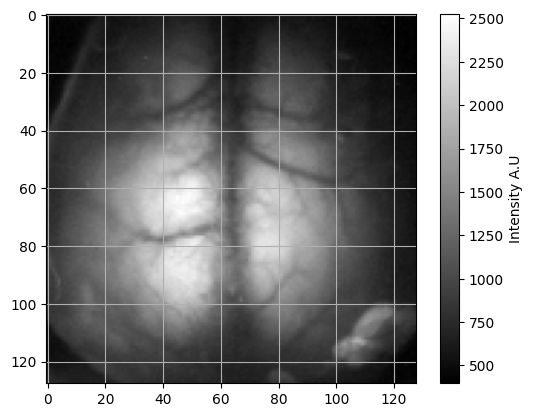

frame number 6000 plotted


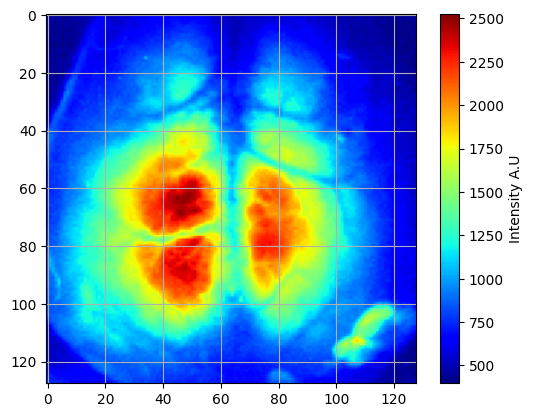

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 444.2263916015625 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 499.7546905517578


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 98
Number of double_flash pairs: 49
Number of single_flash: 39
Number of total flashes: 137


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/137 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/137 [00:01<02:47,  1.23s/it]

  1%|█▏                                                                                | 2/137 [00:02<02:57,  1.31s/it]

  2%|█▊                                                                                | 3/137 [00:03<02:59,  1.34s/it]

  3%|██▍                                                                               | 4/137 [00:05<02:58,  1.35s/it]

  4%|██▉                                                                               | 5/137 [00:06<02:56,  1.34s/it]

  4%|███▌                                                                              | 6/137 [00:07<02:51,  1.31s/it]

  5%|████▏                                                                             | 7/137 [00:09<02:42,  1.25s/it]

  6%|████▊                                                                             | 8/137 [00:10<02:47,  1.30s/it]

  7%|█████▍                                                                            | 9/137 [00:11<02:47,  1.31s/it]

  7%|█████▉                                                                           | 10/137 [00:13<02:47,  1.32s/it]

  8%|██████▌                                                                          | 11/137 [00:14<02:49,  1.34s/it]

  9%|███████                                                                          | 12/137 [00:15<02:46,  1.34s/it]

  9%|███████▋                                                                         | 13/137 [00:17<02:48,  1.36s/it]

 10%|████████▎                                                                        | 14/137 [00:18<02:45,  1.35s/it]

 11%|████████▊                                                                        | 15/137 [00:20<02:49,  1.39s/it]

 12%|█████████▍                                                                       | 16/137 [00:21<02:50,  1.41s/it]

 12%|██████████                                                                       | 17/137 [00:22<02:46,  1.39s/it]

 13%|██████████▋                                                                      | 18/137 [00:24<02:42,  1.36s/it]

 14%|███████████▏                                                                     | 19/137 [00:25<02:39,  1.35s/it]

 15%|███████████▊                                                                     | 20/137 [00:26<02:38,  1.35s/it]

 15%|████████████▍                                                                    | 21/137 [00:28<02:35,  1.34s/it]

 16%|█████████████                                                                    | 22/137 [00:29<02:28,  1.29s/it]

 17%|█████████████▌                                                                   | 23/137 [00:30<02:22,  1.25s/it]

 18%|██████████████▏                                                                  | 24/137 [00:31<02:21,  1.26s/it]

 18%|██████████████▊                                                                  | 25/137 [00:32<02:17,  1.22s/it]

 19%|███████████████▎                                                                 | 26/137 [00:34<02:16,  1.23s/it]

 20%|███████████████▉                                                                 | 27/137 [00:35<02:14,  1.23s/it]

 20%|████████████████▌                                                                | 28/137 [00:36<02:14,  1.23s/it]

 21%|█████████████████▏                                                               | 29/137 [00:37<02:13,  1.24s/it]

 22%|█████████████████▋                                                               | 30/137 [00:39<02:11,  1.23s/it]

 23%|██████████████████▎                                                              | 31/137 [00:40<02:15,  1.28s/it]

 23%|██████████████████▉                                                              | 32/137 [00:41<02:17,  1.31s/it]

 24%|███████████████████▌                                                             | 33/137 [00:43<02:16,  1.31s/it]

 25%|████████████████████                                                             | 34/137 [00:44<02:20,  1.37s/it]

 26%|████████████████████▋                                                            | 35/137 [00:46<02:19,  1.37s/it]

 26%|█████████████████████▎                                                           | 36/137 [00:47<02:19,  1.38s/it]

 27%|█████████████████████▉                                                           | 37/137 [00:48<02:14,  1.34s/it]

 28%|██████████████████████▍                                                          | 38/137 [00:50<02:13,  1.35s/it]

 28%|███████████████████████                                                          | 39/137 [00:51<02:10,  1.33s/it]

 29%|███████████████████████▋                                                         | 40/137 [00:52<02:07,  1.31s/it]

 30%|████████████████████████▏                                                        | 41/137 [00:54<02:09,  1.34s/it]

 31%|████████████████████████▊                                                        | 42/137 [00:55<02:07,  1.34s/it]

 31%|█████████████████████████▍                                                       | 43/137 [00:56<02:03,  1.31s/it]

 32%|██████████████████████████                                                       | 44/137 [00:57<02:01,  1.31s/it]

 33%|██████████████████████████▌                                                      | 45/137 [00:59<01:59,  1.30s/it]

 34%|███████████████████████████▏                                                     | 46/137 [01:00<01:56,  1.28s/it]

 34%|███████████████████████████▊                                                     | 47/137 [01:01<01:56,  1.30s/it]

 35%|████████████████████████████▍                                                    | 48/137 [01:03<01:58,  1.33s/it]

 36%|████████████████████████████▉                                                    | 49/137 [01:04<01:56,  1.33s/it]

 36%|█████████████████████████████▌                                                   | 50/137 [01:05<01:53,  1.31s/it]

 37%|██████████████████████████████▏                                                  | 51/137 [01:07<01:55,  1.34s/it]

 38%|██████████████████████████████▋                                                  | 52/137 [01:08<01:53,  1.34s/it]

 39%|███████████████████████████████▎                                                 | 53/137 [01:09<01:49,  1.31s/it]

 39%|███████████████████████████████▉                                                 | 54/137 [01:11<01:50,  1.33s/it]

 40%|████████████████████████████████▌                                                | 55/137 [01:12<01:48,  1.32s/it]

 41%|█████████████████████████████████                                                | 56/137 [01:13<01:45,  1.30s/it]

 42%|█████████████████████████████████▋                                               | 57/137 [01:14<01:42,  1.28s/it]

 42%|██████████████████████████████████▎                                              | 58/137 [01:16<01:40,  1.28s/it]

 43%|██████████████████████████████████▉                                              | 59/137 [01:17<01:44,  1.34s/it]

 44%|███████████████████████████████████▍                                             | 60/137 [01:19<01:45,  1.37s/it]

 45%|████████████████████████████████████                                             | 61/137 [01:20<01:44,  1.38s/it]

 45%|████████████████████████████████████▋                                            | 62/137 [01:21<01:42,  1.36s/it]

 46%|█████████████████████████████████████▏                                           | 63/137 [01:23<01:39,  1.34s/it]

 47%|█████████████████████████████████████▊                                           | 64/137 [01:24<01:37,  1.33s/it]

 47%|██████████████████████████████████████▍                                          | 65/137 [01:25<01:33,  1.30s/it]

 48%|███████████████████████████████████████                                          | 66/137 [01:27<01:33,  1.32s/it]

 49%|███████████████████████████████████████▌                                         | 67/137 [01:28<01:31,  1.30s/it]

 50%|████████████████████████████████████████▏                                        | 68/137 [01:29<01:28,  1.29s/it]

 50%|████████████████████████████████████████▊                                        | 69/137 [01:30<01:27,  1.29s/it]

 51%|█████████████████████████████████████████▍                                       | 70/137 [01:32<01:25,  1.27s/it]

 52%|█████████████████████████████████████████▉                                       | 71/137 [01:33<01:24,  1.29s/it]

 53%|██████████████████████████████████████████▌                                      | 72/137 [01:34<01:26,  1.33s/it]

 53%|███████████████████████████████████████████▏                                     | 73/137 [01:36<01:25,  1.34s/it]

 54%|███████████████████████████████████████████▊                                     | 74/137 [01:37<01:23,  1.32s/it]

 55%|████████████████████████████████████████████▎                                    | 75/137 [01:38<01:22,  1.33s/it]

 55%|████████████████████████████████████████████▉                                    | 76/137 [01:40<01:21,  1.34s/it]

 56%|█████████████████████████████████████████████▌                                   | 77/137 [01:41<01:18,  1.30s/it]

 57%|██████████████████████████████████████████████                                   | 78/137 [01:42<01:16,  1.30s/it]

 58%|██████████████████████████████████████████████▋                                  | 79/137 [01:43<01:15,  1.30s/it]

 58%|███████████████████████████████████████████████▎                                 | 80/137 [01:45<01:14,  1.31s/it]

 59%|███████████████████████████████████████████████▉                                 | 81/137 [01:46<01:12,  1.29s/it]

 60%|████████████████████████████████████████████████▍                                | 82/137 [01:47<01:08,  1.24s/it]

 61%|█████████████████████████████████████████████████                                | 83/137 [01:49<01:08,  1.27s/it]

 61%|█████████████████████████████████████████████████▋                               | 84/137 [01:50<01:09,  1.31s/it]

 62%|██████████████████████████████████████████████████▎                              | 85/137 [01:51<01:08,  1.32s/it]

 63%|██████████████████████████████████████████████████▊                              | 86/137 [01:52<01:05,  1.29s/it]

 64%|███████████████████████████████████████████████████▍                             | 87/137 [01:54<01:04,  1.28s/it]

 64%|████████████████████████████████████████████████████                             | 88/137 [01:55<01:02,  1.27s/it]

 65%|████████████████████████████████████████████████████▌                            | 89/137 [01:56<01:00,  1.27s/it]

 66%|█████████████████████████████████████████████████████▏                           | 90/137 [01:58<01:00,  1.29s/it]

 66%|█████████████████████████████████████████████████████▊                           | 91/137 [01:59<00:57,  1.25s/it]

 67%|██████████████████████████████████████████████████████▍                          | 92/137 [02:00<00:57,  1.28s/it]

 68%|██████████████████████████████████████████████████████▉                          | 93/137 [02:01<00:55,  1.26s/it]

 69%|███████████████████████████████████████████████████████▌                         | 94/137 [02:03<00:56,  1.31s/it]

 69%|████████████████████████████████████████████████████████▏                        | 95/137 [02:04<00:54,  1.30s/it]

 70%|████████████████████████████████████████████████████████▊                        | 96/137 [02:05<00:52,  1.27s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 97/137 [02:06<00:50,  1.25s/it]

 72%|█████████████████████████████████████████████████████████▉                       | 98/137 [02:08<00:50,  1.29s/it]

 72%|██████████████████████████████████████████████████████████▌                      | 99/137 [02:09<00:50,  1.32s/it]

 73%|██████████████████████████████████████████████████████████▍                     | 100/137 [02:11<00:50,  1.37s/it]

 74%|██████████████████████████████████████████████████████████▉                     | 101/137 [02:12<00:48,  1.35s/it]

 74%|███████████████████████████████████████████████████████████▌                    | 102/137 [02:13<00:47,  1.35s/it]

 75%|████████████████████████████████████████████████████████████▏                   | 103/137 [02:15<00:46,  1.35s/it]

 76%|████████████████████████████████████████████████████████████▋                   | 104/137 [02:16<00:44,  1.35s/it]

 77%|█████████████████████████████████████████████████████████████▎                  | 105/137 [02:17<00:42,  1.33s/it]

 77%|█████████████████████████████████████████████████████████████▉                  | 106/137 [02:19<00:41,  1.35s/it]

 78%|██████████████████████████████████████████████████████████████▍                 | 107/137 [02:20<00:39,  1.31s/it]

 79%|███████████████████████████████████████████████████████████████                 | 108/137 [02:21<00:37,  1.31s/it]

 80%|███████████████████████████████████████████████████████████████▋                | 109/137 [02:23<00:36,  1.29s/it]

 80%|████████████████████████████████████████████████████████████████▏               | 110/137 [02:24<00:35,  1.30s/it]

 81%|████████████████████████████████████████████████████████████████▊               | 111/137 [02:25<00:33,  1.29s/it]

 82%|█████████████████████████████████████████████████████████████████▍              | 112/137 [02:26<00:31,  1.27s/it]

 82%|█████████████████████████████████████████████████████████████████▉              | 113/137 [02:28<00:31,  1.31s/it]

 83%|██████████████████████████████████████████████████████████████████▌             | 114/137 [02:29<00:29,  1.30s/it]

 84%|███████████████████████████████████████████████████████████████████▏            | 115/137 [02:30<00:28,  1.29s/it]

 85%|███████████████████████████████████████████████████████████████████▋            | 116/137 [02:32<00:27,  1.31s/it]

 85%|████████████████████████████████████████████████████████████████████▎           | 117/137 [02:33<00:26,  1.32s/it]

 86%|████████████████████████████████████████████████████████████████████▉           | 118/137 [02:34<00:25,  1.33s/it]

 87%|█████████████████████████████████████████████████████████████████████▍          | 119/137 [02:36<00:24,  1.34s/it]

 88%|██████████████████████████████████████████████████████████████████████          | 120/137 [02:37<00:22,  1.32s/it]

 88%|██████████████████████████████████████████████████████████████████████▋         | 121/137 [02:38<00:20,  1.28s/it]

 89%|███████████████████████████████████████████████████████████████████████▏        | 122/137 [02:39<00:18,  1.26s/it]

 90%|███████████████████████████████████████████████████████████████████████▊        | 123/137 [02:41<00:18,  1.30s/it]

 91%|████████████████████████████████████████████████████████████████████████▍       | 124/137 [02:42<00:16,  1.30s/it]

 91%|████████████████████████████████████████████████████████████████████████▉       | 125/137 [02:43<00:15,  1.32s/it]

 92%|█████████████████████████████████████████████████████████████████████████▌      | 126/137 [02:45<00:14,  1.33s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 127/137 [02:46<00:13,  1.31s/it]

 93%|██████████████████████████████████████████████████████████████████████████▋     | 128/137 [02:47<00:11,  1.28s/it]

 94%|███████████████████████████████████████████████████████████████████████████▎    | 129/137 [02:49<00:10,  1.30s/it]

 95%|███████████████████████████████████████████████████████████████████████████▉    | 130/137 [02:50<00:09,  1.31s/it]

 96%|████████████████████████████████████████████████████████████████████████████▍   | 131/137 [02:51<00:07,  1.32s/it]

 96%|█████████████████████████████████████████████████████████████████████████████   | 132/137 [02:53<00:06,  1.32s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 133/137 [02:54<00:05,  1.31s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 134/137 [02:55<00:04,  1.35s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 135/137 [02:57<00:02,  1.32s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 136/137 [02:58<00:01,  1.29s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 137/137 [02:59<00:00,  1.31s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 137/137 [02:59<00:00,  1.31s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 22%|█████████████████▌                                                              | 28/128 [00:00<00:00, 271.94it/s]

 44%|███████████████████████████████████                                             | 56/128 [00:00<00:00, 261.49it/s]

 65%|███████████████████████████████████████████████████▉                            | 83/128 [00:00<00:00, 261.82it/s]

 86%|███████████████████████████████████████████████████████████████████▉           | 110/128 [00:00<00:00, 259.04it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 261.32it/s]

  0%|                                                                                        | 0/34652 [00:00<?, ?it/s]

  0%|                                                                              | 28/34652 [00:00<02:06, 274.60it/s]

  0%|▏                                                                             | 56/34652 [00:00<02:16, 254.09it/s]

  0%|▏                                                                             | 82/34652 [00:00<02:19, 247.07it/s]

  0%|▏                                                                            | 109/34652 [00:00<02:16, 252.83it/s]

  0%|▎                                                                            | 137/34652 [00:00<02:12, 261.34it/s]

  0%|▎                                                                            | 164/34652 [00:00<02:12, 259.94it/s]

  1%|▍                                                                            | 191/34652 [00:00<02:21, 244.27it/s]

  1%|▍                                                                            | 216/34652 [00:00<02:31, 227.81it/s]

  1%|▌                                                                            | 240/34652 [00:00<02:33, 224.32it/s]

  1%|▌                                                                            | 268/34652 [00:01<02:24, 237.30it/s]

  1%|▋                                                                            | 292/34652 [00:01<02:26, 234.10it/s]

  1%|▋                                                                            | 316/34652 [00:01<02:33, 223.70it/s]

  1%|▊                                                                            | 339/34652 [00:01<02:33, 224.23it/s]

  1%|▊                                                                            | 364/34652 [00:01<02:28, 230.25it/s]

  1%|▊                                                                            | 390/34652 [00:01<02:24, 236.78it/s]

  1%|▉                                                                            | 417/34652 [00:01<02:19, 245.70it/s]

  1%|▉                                                                            | 443/34652 [00:01<02:18, 247.73it/s]

  1%|█                                                                            | 468/34652 [00:01<02:19, 245.55it/s]

  1%|█                                                                            | 494/34652 [00:02<02:17, 247.63it/s]

  2%|█▏                                                                           | 521/34652 [00:02<02:14, 253.46it/s]

  2%|█▏                                                                           | 547/34652 [00:02<02:16, 249.54it/s]

  2%|█▎                                                                           | 575/34652 [00:02<02:12, 257.68it/s]

  2%|█▎                                                                           | 604/34652 [00:02<02:08, 265.63it/s]

  2%|█▍                                                                           | 631/34652 [00:02<02:13, 254.95it/s]

  2%|█▍                                                                           | 660/34652 [00:02<02:08, 264.26it/s]

  2%|█▌                                                                           | 689/34652 [00:02<02:05, 270.18it/s]

  2%|█▌                                                                           | 718/34652 [00:02<02:03, 275.18it/s]

  2%|█▋                                                                           | 747/34652 [00:02<02:01, 277.93it/s]

  2%|█▋                                                                           | 777/34652 [00:03<02:00, 281.14it/s]

  2%|█▊                                                                           | 806/34652 [00:03<02:07, 265.83it/s]

  2%|█▊                                                                           | 833/34652 [00:03<02:11, 256.89it/s]

  2%|█▉                                                                           | 859/34652 [00:03<02:15, 249.43it/s]

  3%|█▉                                                                           | 887/34652 [00:03<02:11, 255.83it/s]

  3%|██                                                                           | 915/34652 [00:03<02:09, 261.27it/s]

  3%|██                                                                           | 942/34652 [00:03<02:19, 242.27it/s]

  3%|██▏                                                                          | 971/34652 [00:03<02:12, 254.04it/s]

  3%|██▏                                                                         | 1000/34652 [00:03<02:07, 263.39it/s]

  3%|██▎                                                                         | 1027/34652 [00:04<02:10, 257.07it/s]

  3%|██▎                                                                         | 1053/34652 [00:04<02:12, 252.93it/s]

  3%|██▎                                                                         | 1079/34652 [00:04<02:13, 251.39it/s]

  3%|██▍                                                                         | 1108/34652 [00:04<02:08, 260.96it/s]

  3%|██▍                                                                         | 1137/34652 [00:04<02:04, 268.59it/s]

  3%|██▌                                                                         | 1164/34652 [00:04<02:13, 250.77it/s]

  3%|██▌                                                                         | 1190/34652 [00:04<02:13, 249.88it/s]

  4%|██▋                                                                         | 1216/34652 [00:04<02:13, 251.35it/s]

  4%|██▋                                                                         | 1242/34652 [00:04<02:16, 245.42it/s]

  4%|██▊                                                                         | 1267/34652 [00:05<02:17, 242.61it/s]

  4%|██▊                                                                         | 1294/34652 [00:05<02:14, 248.32it/s]

  4%|██▉                                                                         | 1322/34652 [00:05<02:10, 255.98it/s]

  4%|██▉                                                                         | 1350/34652 [00:05<02:07, 261.46it/s]

  4%|███                                                                         | 1377/34652 [00:05<02:07, 261.69it/s]

  4%|███                                                                         | 1404/34652 [00:05<02:11, 252.34it/s]

  4%|███▏                                                                        | 1433/34652 [00:05<02:06, 261.62it/s]

  4%|███▏                                                                        | 1462/34652 [00:05<02:03, 268.28it/s]

  4%|███▎                                                                        | 1491/34652 [00:05<02:01, 273.83it/s]

  4%|███▎                                                                        | 1520/34652 [00:05<01:59, 277.78it/s]

  4%|███▍                                                                        | 1548/34652 [00:06<02:04, 265.94it/s]

  5%|███▍                                                                        | 1577/34652 [00:06<02:01, 271.31it/s]

  5%|███▌                                                                        | 1605/34652 [00:06<02:11, 251.32it/s]

  5%|███▌                                                                        | 1631/34652 [00:06<02:13, 247.60it/s]

  5%|███▋                                                                        | 1656/34652 [00:06<02:13, 246.24it/s]

  5%|███▋                                                                        | 1681/34652 [00:06<02:16, 241.55it/s]

  5%|███▋                                                                        | 1708/34652 [00:06<02:13, 247.51it/s]

  5%|███▊                                                                        | 1735/34652 [00:06<02:10, 252.52it/s]

  5%|███▊                                                                        | 1761/34652 [00:06<02:10, 252.52it/s]

  5%|███▉                                                                        | 1789/34652 [00:07<02:06, 260.06it/s]

  5%|███▉                                                                        | 1816/34652 [00:07<02:15, 241.90it/s]

  5%|████                                                                        | 1842/34652 [00:07<02:13, 244.91it/s]

  5%|████                                                                        | 1870/34652 [00:07<02:09, 252.71it/s]

  5%|████▏                                                                       | 1896/34652 [00:07<02:17, 237.83it/s]

  6%|████▏                                                                       | 1921/34652 [00:07<02:19, 235.37it/s]

  6%|████▎                                                                       | 1945/34652 [00:07<02:19, 234.72it/s]

  6%|████▎                                                                       | 1970/34652 [00:07<02:17, 237.05it/s]

  6%|████▎                                                                       | 1994/34652 [00:07<02:21, 230.03it/s]

  6%|████▍                                                                       | 2018/34652 [00:08<02:22, 228.35it/s]

  6%|████▍                                                                       | 2045/34652 [00:08<02:18, 236.18it/s]

  6%|████▌                                                                       | 2069/34652 [00:08<02:18, 234.62it/s]

  6%|████▌                                                                       | 2097/34652 [00:08<02:12, 245.56it/s]

  6%|████▋                                                                       | 2123/34652 [00:08<02:11, 247.61it/s]

  6%|████▋                                                                       | 2149/34652 [00:08<02:10, 249.07it/s]

  6%|████▊                                                                       | 2177/34652 [00:08<02:06, 255.87it/s]

  6%|████▊                                                                       | 2203/34652 [00:08<02:09, 249.81it/s]

  6%|████▉                                                                       | 2230/34652 [00:08<02:10, 249.19it/s]

  7%|████▉                                                                       | 2257/34652 [00:08<02:08, 253.01it/s]

  7%|█████                                                                       | 2283/34652 [00:09<02:16, 236.61it/s]

  7%|█████                                                                       | 2308/34652 [00:09<02:15, 239.01it/s]

  7%|█████                                                                       | 2335/34652 [00:09<02:11, 246.40it/s]

  7%|█████▏                                                                      | 2360/34652 [00:09<02:11, 246.04it/s]

  7%|█████▏                                                                      | 2387/34652 [00:09<02:08, 250.82it/s]

  7%|█████▎                                                                      | 2413/34652 [00:09<02:13, 240.92it/s]

  7%|█████▎                                                                      | 2440/34652 [00:09<02:09, 248.77it/s]

  7%|█████▍                                                                      | 2466/34652 [00:09<02:09, 249.20it/s]

  7%|█████▍                                                                      | 2492/34652 [00:09<02:09, 248.51it/s]

  7%|█████▌                                                                      | 2517/34652 [00:10<02:10, 246.83it/s]

  7%|█████▌                                                                      | 2545/34652 [00:10<02:06, 254.34it/s]

  7%|█████▋                                                                      | 2571/34652 [00:10<02:05, 255.57it/s]

  8%|█████▋                                                                      | 2600/34652 [00:10<02:01, 264.45it/s]

  8%|█████▊                                                                      | 2629/34652 [00:10<01:57, 271.72it/s]

  8%|█████▊                                                                      | 2657/34652 [00:10<01:58, 270.99it/s]

  8%|█████▉                                                                      | 2686/34652 [00:10<01:55, 275.81it/s]

  8%|█████▉                                                                      | 2714/34652 [00:10<01:58, 269.90it/s]

  8%|██████                                                                      | 2742/34652 [00:10<02:03, 257.84it/s]

  8%|██████                                                                      | 2768/34652 [00:11<02:06, 252.76it/s]

  8%|██████▏                                                                     | 2794/34652 [00:11<02:09, 245.80it/s]

  8%|██████▏                                                                     | 2821/34652 [00:11<02:06, 251.91it/s]

  8%|██████▎                                                                     | 2850/34652 [00:11<02:02, 259.84it/s]

  8%|██████▎                                                                     | 2877/34652 [00:11<02:05, 254.03it/s]

  8%|██████▎                                                                     | 2903/34652 [00:11<02:09, 244.63it/s]

  8%|██████▍                                                                     | 2931/34652 [00:11<02:06, 251.73it/s]

  9%|██████▍                                                                     | 2957/34652 [00:11<02:08, 246.42it/s]

  9%|██████▌                                                                     | 2984/34652 [00:11<02:05, 252.38it/s]

  9%|██████▌                                                                     | 3010/34652 [00:11<02:05, 252.42it/s]

  9%|██████▋                                                                     | 3038/34652 [00:12<02:02, 257.44it/s]

  9%|██████▋                                                                     | 3066/34652 [00:12<02:00, 262.48it/s]

  9%|██████▊                                                                     | 3093/34652 [00:12<02:00, 262.40it/s]

  9%|██████▊                                                                     | 3120/34652 [00:12<02:00, 261.59it/s]

  9%|██████▉                                                                     | 3149/34652 [00:12<01:57, 268.35it/s]

  9%|██████▉                                                                     | 3176/34652 [00:12<02:05, 250.50it/s]

  9%|███████                                                                     | 3203/34652 [00:12<02:03, 253.91it/s]

  9%|███████                                                                     | 3232/34652 [00:12<01:59, 263.25it/s]

  9%|███████▏                                                                    | 3259/34652 [00:12<02:04, 252.14it/s]

  9%|███████▏                                                                    | 3287/34652 [00:13<02:01, 258.55it/s]

 10%|███████▎                                                                    | 3314/34652 [00:13<02:07, 245.71it/s]

 10%|███████▎                                                                    | 3339/34652 [00:13<02:07, 246.24it/s]

 10%|███████▍                                                                    | 3367/34652 [00:13<02:03, 253.66it/s]

 10%|███████▍                                                                    | 3393/34652 [00:13<02:07, 245.66it/s]

 10%|███████▌                                                                    | 3420/34652 [00:13<02:05, 249.74it/s]

 10%|███████▌                                                                    | 3447/34652 [00:13<02:02, 254.09it/s]

 10%|███████▌                                                                    | 3475/34652 [00:13<02:00, 258.60it/s]

 10%|███████▋                                                                    | 3501/34652 [00:13<02:06, 245.54it/s]

 10%|███████▋                                                                    | 3529/34652 [00:14<02:02, 253.13it/s]

 10%|███████▊                                                                    | 3557/34652 [00:14<02:00, 258.60it/s]

 10%|███████▊                                                                    | 3585/34652 [00:14<01:58, 263.27it/s]

 10%|███████▉                                                                    | 3612/34652 [00:14<02:00, 258.50it/s]

 11%|███████▉                                                                    | 3639/34652 [00:14<01:59, 260.34it/s]

 11%|████████                                                                    | 3666/34652 [00:14<02:07, 242.10it/s]

 11%|████████                                                                    | 3691/34652 [00:14<02:13, 231.53it/s]

 11%|████████▏                                                                   | 3718/34652 [00:14<02:08, 241.36it/s]

 11%|████████▏                                                                   | 3743/34652 [00:14<02:11, 235.26it/s]

 11%|████████▎                                                                   | 3767/34652 [00:14<02:12, 233.35it/s]

 11%|████████▎                                                                   | 3794/34652 [00:15<02:07, 242.33it/s]

 11%|████████▍                                                                   | 3819/34652 [00:15<02:08, 239.75it/s]

 11%|████████▍                                                                   | 3847/34652 [00:15<02:02, 250.57it/s]

 11%|████████▍                                                                   | 3875/34652 [00:15<01:59, 256.88it/s]

 11%|████████▌                                                                   | 3901/34652 [00:15<02:00, 254.85it/s]

 11%|████████▌                                                                   | 3929/34652 [00:15<01:58, 259.18it/s]

 11%|████████▋                                                                   | 3956/34652 [00:15<01:57, 262.12it/s]

 11%|████████▋                                                                   | 3983/34652 [00:15<01:57, 261.55it/s]

 12%|████████▊                                                                   | 4010/34652 [00:15<01:56, 262.52it/s]

 12%|████████▊                                                                   | 4039/34652 [00:16<01:54, 268.26it/s]

 12%|████████▉                                                                   | 4066/34652 [00:16<01:55, 264.14it/s]

 12%|████████▉                                                                   | 4094/34652 [00:16<01:54, 267.24it/s]

 12%|█████████                                                                   | 4123/34652 [00:16<01:52, 270.77it/s]

 12%|█████████                                                                   | 4151/34652 [00:16<01:53, 268.78it/s]

 12%|█████████▏                                                                  | 4179/34652 [00:16<01:52, 269.72it/s]

 12%|█████████▏                                                                  | 4208/34652 [00:16<01:51, 273.28it/s]

 12%|█████████▎                                                                  | 4238/34652 [00:16<01:49, 277.88it/s]

 12%|█████████▎                                                                  | 4266/34652 [00:16<01:51, 272.16it/s]

 12%|█████████▍                                                                  | 4294/34652 [00:16<01:52, 269.00it/s]

 12%|█████████▍                                                                  | 4323/34652 [00:17<01:50, 273.51it/s]

 13%|█████████▌                                                                  | 4352/34652 [00:17<01:49, 275.93it/s]

 13%|█████████▌                                                                  | 4380/34652 [00:17<01:51, 272.38it/s]

 13%|█████████▋                                                                  | 4408/34652 [00:17<01:54, 263.89it/s]

 13%|█████████▋                                                                  | 4435/34652 [00:17<01:57, 257.58it/s]

 13%|█████████▊                                                                  | 4461/34652 [00:17<01:58, 255.40it/s]

 13%|█████████▊                                                                  | 4487/34652 [00:17<01:57, 256.01it/s]

 13%|█████████▉                                                                  | 4514/34652 [00:17<01:56, 259.33it/s]

 13%|█████████▉                                                                  | 4540/34652 [00:17<01:57, 256.56it/s]

 13%|██████████                                                                  | 4568/34652 [00:18<01:55, 260.39it/s]

 13%|██████████                                                                  | 4598/34652 [00:18<01:51, 268.84it/s]

 13%|██████████▏                                                                 | 4625/34652 [00:18<01:57, 255.77it/s]

 13%|██████████▏                                                                 | 4652/34652 [00:18<01:56, 258.37it/s]

 13%|██████████▎                                                                 | 4678/34652 [00:18<01:57, 255.92it/s]

 14%|██████████▎                                                                 | 4705/34652 [00:18<01:55, 259.27it/s]

 14%|██████████▍                                                                 | 4733/34652 [00:18<01:53, 263.80it/s]

 14%|██████████▍                                                                 | 4762/34652 [00:18<01:50, 269.43it/s]

 14%|██████████▌                                                                 | 4789/34652 [00:18<01:51, 267.92it/s]

 14%|██████████▌                                                                 | 4817/34652 [00:18<01:50, 271.04it/s]

 14%|██████████▋                                                                 | 4845/34652 [00:19<01:50, 270.06it/s]

 14%|██████████▋                                                                 | 4873/34652 [00:19<01:53, 262.80it/s]

 14%|██████████▊                                                                 | 4902/34652 [00:19<01:50, 268.34it/s]

 14%|██████████▊                                                                 | 4932/34652 [00:19<01:47, 275.94it/s]

 14%|██████████▉                                                                 | 4960/34652 [00:19<01:49, 272.18it/s]

 14%|██████████▉                                                                 | 4988/34652 [00:19<01:53, 262.30it/s]

 14%|██████████▉                                                                 | 5015/34652 [00:19<01:53, 260.81it/s]

 15%|███████████                                                                 | 5044/34652 [00:19<01:50, 266.89it/s]

 15%|███████████▏                                                                | 5073/34652 [00:19<01:49, 271.23it/s]

 15%|███████████▏                                                                | 5101/34652 [00:20<01:49, 269.89it/s]

 15%|███████████▏                                                                | 5129/34652 [00:20<01:50, 266.67it/s]

 15%|███████████▎                                                                | 5157/34652 [00:20<01:49, 269.76it/s]

 15%|███████████▎                                                                | 5185/34652 [00:20<01:48, 270.41it/s]

 15%|███████████▍                                                                | 5213/34652 [00:20<01:50, 265.49it/s]

 15%|███████████▍                                                                | 5242/34652 [00:20<01:48, 270.25it/s]

 15%|███████████▌                                                                | 5270/34652 [00:20<01:52, 261.72it/s]

 15%|███████████▌                                                                | 5297/34652 [00:20<01:53, 259.67it/s]

 15%|███████████▋                                                                | 5326/34652 [00:20<01:50, 266.08it/s]

 15%|███████████▋                                                                | 5354/34652 [00:20<01:49, 267.80it/s]

 16%|███████████▊                                                                | 5381/34652 [00:21<01:50, 263.88it/s]

 16%|███████████▊                                                                | 5410/34652 [00:21<01:48, 269.90it/s]

 16%|███████████▉                                                                | 5438/34652 [00:21<01:54, 254.36it/s]

 16%|███████████▉                                                                | 5464/34652 [00:21<01:56, 250.37it/s]

 16%|████████████                                                                | 5491/34652 [00:21<01:54, 254.48it/s]

 16%|████████████                                                                | 5518/34652 [00:21<01:52, 258.19it/s]

 16%|████████████▏                                                               | 5544/34652 [00:21<01:58, 244.71it/s]

 16%|████████████▏                                                               | 5573/34652 [00:21<01:53, 255.30it/s]

 16%|████████████▎                                                               | 5601/34652 [00:21<01:51, 260.13it/s]

 16%|████████████▎                                                               | 5628/34652 [00:22<01:54, 254.23it/s]

 16%|████████████▍                                                               | 5654/34652 [00:22<01:59, 241.68it/s]

 16%|████████████▍                                                               | 5679/34652 [00:22<02:08, 225.01it/s]

 16%|████████████▌                                                               | 5705/34652 [00:22<02:04, 232.22it/s]

 17%|████████████▌                                                               | 5730/34652 [00:22<02:02, 235.83it/s]

 17%|████████████▋                                                               | 5757/34652 [00:22<01:58, 244.08it/s]

 17%|████████████▋                                                               | 5783/34652 [00:22<01:56, 247.23it/s]

 17%|████████████▋                                                               | 5808/34652 [00:22<01:59, 240.43it/s]

 17%|████████████▊                                                               | 5836/34652 [00:22<01:55, 250.32it/s]

 17%|████████████▊                                                               | 5862/34652 [00:23<01:55, 249.54it/s]

 17%|████████████▉                                                               | 5888/34652 [00:23<01:56, 246.88it/s]

 17%|████████████▉                                                               | 5913/34652 [00:23<01:57, 244.29it/s]

 17%|█████████████                                                               | 5938/34652 [00:23<01:59, 239.75it/s]

 17%|█████████████                                                               | 5965/34652 [00:23<01:56, 246.32it/s]

 17%|█████████████▏                                                              | 5990/34652 [00:23<01:57, 243.89it/s]

 17%|█████████████▏                                                              | 6019/34652 [00:23<01:52, 255.03it/s]

 17%|█████████████▎                                                              | 6045/34652 [00:23<01:57, 244.43it/s]

 18%|█████████████▎                                                              | 6070/34652 [00:23<01:57, 242.60it/s]

 18%|█████████████▎                                                              | 6095/34652 [00:23<01:59, 239.28it/s]

 18%|█████████████▍                                                              | 6119/34652 [00:24<02:00, 236.81it/s]

 18%|█████████████▍                                                              | 6145/34652 [00:24<01:57, 242.79it/s]

 18%|█████████████▌                                                              | 6170/34652 [00:24<01:57, 242.72it/s]

 18%|█████████████▌                                                              | 6195/34652 [00:24<02:00, 236.67it/s]

 18%|█████████████▋                                                              | 6221/34652 [00:24<01:57, 242.00it/s]

 18%|█████████████▋                                                              | 6246/34652 [00:24<01:59, 238.14it/s]

 18%|█████████████▊                                                              | 6275/34652 [00:24<01:52, 252.37it/s]

 18%|█████████████▊                                                              | 6303/34652 [00:24<01:49, 258.20it/s]

 18%|█████████████▉                                                              | 6332/34652 [00:24<01:46, 265.91it/s]

 18%|█████████████▉                                                              | 6361/34652 [00:25<01:43, 272.19it/s]

 18%|██████████████                                                              | 6389/34652 [00:25<01:47, 262.91it/s]

 19%|██████████████                                                              | 6417/34652 [00:25<01:46, 265.56it/s]

 19%|██████████████▏                                                             | 6444/34652 [00:25<01:47, 261.58it/s]

 19%|██████████████▏                                                             | 6471/34652 [00:25<01:47, 262.52it/s]

 19%|██████████████▎                                                             | 6499/34652 [00:25<01:45, 266.08it/s]

 19%|██████████████▎                                                             | 6526/34652 [00:25<01:48, 260.41it/s]

 19%|██████████████▎                                                             | 6553/34652 [00:25<01:53, 246.80it/s]

 19%|██████████████▍                                                             | 6578/34652 [00:25<02:02, 229.76it/s]

 19%|██████████████▍                                                             | 6606/34652 [00:26<01:56, 241.40it/s]

 19%|██████████████▌                                                             | 6633/34652 [00:26<01:52, 247.97it/s]

 19%|██████████████▌                                                             | 6659/34652 [00:26<01:54, 245.16it/s]

 19%|██████████████▋                                                             | 6684/34652 [00:26<01:57, 237.18it/s]

 19%|██████████████▋                                                             | 6710/34652 [00:26<01:55, 242.90it/s]

 19%|██████████████▊                                                             | 6739/34652 [00:26<01:49, 254.89it/s]

 20%|██████████████▊                                                             | 6765/34652 [00:26<01:54, 243.09it/s]

 20%|██████████████▉                                                             | 6790/34652 [00:26<02:01, 228.39it/s]

 20%|██████████████▉                                                             | 6814/34652 [00:26<02:01, 228.46it/s]

 20%|██████████████▉                                                             | 6838/34652 [00:27<02:04, 223.03it/s]

 20%|███████████████                                                             | 6867/34652 [00:27<01:57, 236.96it/s]

 20%|███████████████                                                             | 6891/34652 [00:27<02:06, 220.04it/s]

 20%|███████████████▏                                                            | 6915/34652 [00:27<02:04, 223.03it/s]

 20%|███████████████▏                                                            | 6943/34652 [00:27<01:57, 236.81it/s]

 20%|███████████████▎                                                            | 6970/34652 [00:27<01:53, 244.78it/s]

 20%|███████████████▎                                                            | 6997/34652 [00:27<01:50, 251.29it/s]

 20%|███████████████▍                                                            | 7023/34652 [00:27<01:53, 243.90it/s]

 20%|███████████████▍                                                            | 7049/34652 [00:27<01:51, 247.79it/s]

 20%|███████████████▌                                                            | 7077/34652 [00:27<01:47, 255.91it/s]

 21%|███████████████▌                                                            | 7106/34652 [00:28<01:44, 264.62it/s]

 21%|███████████████▋                                                            | 7133/34652 [00:28<01:46, 257.85it/s]

 21%|███████████████▋                                                            | 7162/34652 [00:28<01:43, 265.53it/s]

 21%|███████████████▊                                                            | 7190/34652 [00:28<01:42, 266.74it/s]

 21%|███████████████▊                                                            | 7217/34652 [00:28<01:46, 258.69it/s]

 21%|███████████████▉                                                            | 7243/34652 [00:28<01:50, 249.10it/s]

 21%|███████████████▉                                                            | 7269/34652 [00:28<01:55, 237.45it/s]

 21%|███████████████▉                                                            | 7294/34652 [00:28<01:53, 240.87it/s]

 21%|████████████████                                                            | 7322/34652 [00:28<01:49, 249.89it/s]

 21%|████████████████                                                            | 7350/34652 [00:29<01:46, 255.60it/s]

 21%|████████████████▏                                                           | 7376/34652 [00:29<01:47, 253.59it/s]

 21%|████████████████▏                                                           | 7402/34652 [00:29<01:51, 243.75it/s]

 21%|████████████████▎                                                           | 7428/34652 [00:29<01:50, 246.70it/s]

 22%|████████████████▎                                                           | 7453/34652 [00:29<01:50, 245.56it/s]

 22%|████████████████▍                                                           | 7480/34652 [00:29<01:48, 250.47it/s]

 22%|████████████████▍                                                           | 7506/34652 [00:29<01:48, 251.07it/s]

 22%|████████████████▌                                                           | 7534/34652 [00:29<01:46, 254.34it/s]

 22%|████████████████▌                                                           | 7561/34652 [00:29<01:45, 256.61it/s]

 22%|████████████████▋                                                           | 7587/34652 [00:30<01:52, 241.53it/s]

 22%|████████████████▋                                                           | 7612/34652 [00:30<01:57, 229.16it/s]

 22%|████████████████▊                                                           | 7639/34652 [00:30<01:53, 239.04it/s]

 22%|████████████████▊                                                           | 7664/34652 [00:30<01:59, 226.30it/s]

 22%|████████████████▊                                                           | 7688/34652 [00:30<01:57, 228.81it/s]

 22%|████████████████▉                                                           | 7716/34652 [00:30<01:52, 240.42it/s]

 22%|████████████████▉                                                           | 7741/34652 [00:30<01:51, 240.44it/s]

 22%|█████████████████                                                           | 7766/34652 [00:30<01:58, 226.40it/s]

 22%|█████████████████                                                           | 7795/34652 [00:30<01:50, 242.58it/s]

 23%|█████████████████▏                                                          | 7824/34652 [00:30<01:45, 255.10it/s]

 23%|█████████████████▏                                                          | 7851/34652 [00:31<01:43, 258.23it/s]

 23%|█████████████████▎                                                          | 7878/34652 [00:31<01:45, 253.05it/s]

 23%|█████████████████▎                                                          | 7904/34652 [00:31<01:48, 246.83it/s]

 23%|█████████████████▍                                                          | 7929/34652 [00:31<01:52, 238.31it/s]

 23%|█████████████████▍                                                          | 7957/34652 [00:31<01:47, 247.24it/s]

 23%|█████████████████▌                                                          | 7984/34652 [00:31<01:45, 253.00it/s]

 23%|█████████████████▌                                                          | 8012/34652 [00:31<01:43, 258.56it/s]

 23%|█████████████████▋                                                          | 8038/34652 [00:31<01:43, 256.04it/s]

 23%|█████████████████▋                                                          | 8064/34652 [00:31<01:45, 251.38it/s]

 23%|█████████████████▋                                                          | 8090/34652 [00:32<01:48, 245.40it/s]

 23%|█████████████████▊                                                          | 8115/34652 [00:32<01:49, 242.59it/s]

 23%|█████████████████▊                                                          | 8141/34652 [00:32<01:48, 244.79it/s]

 24%|█████████████████▉                                                          | 8169/34652 [00:32<01:44, 253.49it/s]

 24%|█████████████████▉                                                          | 8195/34652 [00:32<01:45, 251.03it/s]

 24%|██████████████████                                                          | 8223/34652 [00:32<01:42, 257.21it/s]

 24%|██████████████████                                                          | 8249/34652 [00:32<01:45, 250.05it/s]

 24%|██████████████████▏                                                         | 8275/34652 [00:32<01:47, 245.88it/s]

 24%|██████████████████▏                                                         | 8300/34652 [00:32<01:49, 241.57it/s]

 24%|██████████████████▎                                                         | 8325/34652 [00:33<01:49, 241.25it/s]

 24%|██████████████████▎                                                         | 8351/34652 [00:33<01:47, 243.86it/s]

 24%|██████████████████▎                                                         | 8378/34652 [00:33<01:44, 250.70it/s]

 24%|██████████████████▍                                                         | 8405/34652 [00:33<01:42, 254.86it/s]

 24%|██████████████████▍                                                         | 8433/34652 [00:33<01:41, 259.21it/s]

 24%|██████████████████▌                                                         | 8462/34652 [00:33<01:38, 265.91it/s]

 24%|██████████████████▌                                                         | 8489/34652 [00:33<01:38, 266.35it/s]

 25%|██████████████████▋                                                         | 8516/34652 [00:33<01:38, 265.15it/s]

 25%|██████████████████▋                                                         | 8543/34652 [00:33<01:38, 264.12it/s]

 25%|██████████████████▊                                                         | 8572/34652 [00:33<01:36, 270.46it/s]

 25%|██████████████████▊                                                         | 8600/34652 [00:34<01:41, 257.92it/s]

 25%|██████████████████▉                                                         | 8626/34652 [00:34<01:40, 258.29it/s]

 25%|██████████████████▉                                                         | 8652/34652 [00:34<01:42, 252.97it/s]

 25%|███████████████████                                                         | 8678/34652 [00:34<01:42, 254.29it/s]

 25%|███████████████████                                                         | 8707/34652 [00:34<01:38, 263.16it/s]

 25%|███████████████████▏                                                        | 8734/34652 [00:34<01:41, 256.21it/s]

 25%|███████████████████▏                                                        | 8760/34652 [00:34<01:41, 255.12it/s]

 25%|███████████████████▎                                                        | 8786/34652 [00:34<01:41, 254.35it/s]

 25%|███████████████████▎                                                        | 8812/34652 [00:34<01:43, 248.79it/s]

 26%|███████████████████▍                                                        | 8840/34652 [00:35<01:40, 256.32it/s]

 26%|███████████████████▍                                                        | 8866/34652 [00:35<01:46, 242.64it/s]

 26%|███████████████████▌                                                        | 8891/34652 [00:35<01:47, 240.68it/s]

 26%|███████████████████▌                                                        | 8916/34652 [00:35<01:47, 239.94it/s]

 26%|███████████████████▌                                                        | 8941/34652 [00:35<01:51, 231.62it/s]

 26%|███████████████████▋                                                        | 8965/34652 [00:35<01:51, 231.35it/s]

 26%|███████████████████▋                                                        | 8994/34652 [00:35<01:44, 246.64it/s]

 26%|███████████████████▊                                                        | 9021/34652 [00:35<01:42, 250.49it/s]

 26%|███████████████████▊                                                        | 9050/34652 [00:35<01:38, 261.16it/s]

 26%|███████████████████▉                                                        | 9079/34652 [00:35<01:35, 268.03it/s]

 26%|███████████████████▉                                                        | 9109/34652 [00:36<01:32, 275.80it/s]

 26%|████████████████████                                                        | 9137/34652 [00:36<01:44, 244.10it/s]

 26%|████████████████████                                                        | 9163/34652 [00:36<01:47, 236.91it/s]

 27%|████████████████████▏                                                       | 9191/34652 [00:36<01:43, 245.87it/s]

 27%|████████████████████▏                                                       | 9219/34652 [00:36<01:40, 253.20it/s]

 27%|████████████████████▎                                                       | 9245/34652 [00:36<01:44, 242.87it/s]

 27%|████████████████████▎                                                       | 9270/34652 [00:36<01:47, 235.43it/s]

 27%|████████████████████▍                                                       | 9295/34652 [00:36<01:46, 237.50it/s]

 27%|████████████████████▍                                                       | 9319/34652 [00:36<01:51, 226.78it/s]

 27%|████████████████████▌                                                       | 9347/34652 [00:37<01:45, 239.62it/s]

 27%|████████████████████▌                                                       | 9372/34652 [00:37<01:46, 237.23it/s]

 27%|████████████████████▌                                                       | 9398/34652 [00:37<01:44, 241.96it/s]

 27%|████████████████████▋                                                       | 9423/34652 [00:37<01:49, 231.08it/s]

 27%|████████████████████▋                                                       | 9450/34652 [00:37<01:44, 240.61it/s]

 27%|████████████████████▊                                                       | 9477/34652 [00:37<01:41, 247.56it/s]

 27%|████████████████████▊                                                       | 9506/34652 [00:37<01:37, 259.03it/s]

 28%|████████████████████▉                                                       | 9533/34652 [00:37<01:41, 247.18it/s]

 28%|████████████████████▉                                                       | 9558/34652 [00:37<01:44, 239.90it/s]

 28%|█████████████████████                                                       | 9584/34652 [00:38<01:43, 242.83it/s]

 28%|█████████████████████                                                       | 9609/34652 [00:38<01:43, 241.47it/s]

 28%|█████████████████████▏                                                      | 9634/34652 [00:38<01:46, 235.21it/s]

 28%|█████████████████████▏                                                      | 9658/34652 [00:38<01:46, 235.25it/s]

 28%|█████████████████████▏                                                      | 9687/34652 [00:38<01:40, 249.52it/s]

 28%|█████████████████████▎                                                      | 9713/34652 [00:38<01:41, 246.87it/s]

 28%|█████████████████████▎                                                      | 9742/34652 [00:38<01:36, 257.81it/s]

 28%|█████████████████████▍                                                      | 9768/34652 [00:38<01:36, 257.73it/s]

 28%|█████████████████████▍                                                      | 9794/34652 [00:38<01:40, 248.26it/s]

 28%|█████████████████████▌                                                      | 9820/34652 [00:39<01:39, 249.50it/s]

 28%|█████████████████████▌                                                      | 9848/34652 [00:39<01:36, 256.11it/s]

 28%|█████████████████████▋                                                      | 9874/34652 [00:39<01:38, 251.43it/s]

 29%|█████████████████████▋                                                      | 9900/34652 [00:39<01:38, 250.32it/s]

 29%|█████████████████████▊                                                      | 9929/34652 [00:39<01:34, 260.30it/s]

 29%|█████████████████████▊                                                      | 9956/34652 [00:39<01:36, 255.71it/s]

 29%|█████████████████████▉                                                      | 9983/34652 [00:39<01:35, 257.63it/s]

 29%|█████████████████████▋                                                     | 10009/34652 [00:39<01:38, 249.09it/s]

 29%|█████████████████████▋                                                     | 10034/34652 [00:39<01:41, 243.26it/s]

 29%|█████████████████████▊                                                     | 10059/34652 [00:39<01:44, 235.82it/s]

 29%|█████████████████████▊                                                     | 10083/34652 [00:40<01:44, 234.38it/s]

 29%|█████████████████████▉                                                     | 10107/34652 [00:40<01:46, 230.76it/s]

 29%|█████████████████████▉                                                     | 10131/34652 [00:40<01:47, 228.86it/s]

 29%|█████████████████████▉                                                     | 10158/34652 [00:40<01:42, 239.23it/s]

 29%|██████████████████████                                                     | 10185/34652 [00:40<01:38, 247.41it/s]

 29%|██████████████████████                                                     | 10210/34652 [00:40<01:44, 234.54it/s]

 30%|██████████████████████▏                                                    | 10234/34652 [00:40<01:44, 232.82it/s]

 30%|██████████████████████▏                                                    | 10263/34652 [00:40<01:38, 247.70it/s]

 30%|██████████████████████▎                                                    | 10291/34652 [00:40<01:35, 256.28it/s]

 30%|██████████████████████▎                                                    | 10317/34652 [00:41<01:37, 250.12it/s]

 30%|██████████████████████▍                                                    | 10343/34652 [00:41<01:37, 249.40it/s]

 30%|██████████████████████▍                                                    | 10370/34652 [00:41<01:36, 252.45it/s]

 30%|██████████████████████▌                                                    | 10397/34652 [00:41<01:35, 254.61it/s]

 30%|██████████████████████▌                                                    | 10424/34652 [00:41<01:34, 256.87it/s]

 30%|██████████████████████▌                                                    | 10450/34652 [00:41<01:37, 247.02it/s]

 30%|██████████████████████▋                                                    | 10475/34652 [00:41<01:37, 247.19it/s]

 30%|██████████████████████▋                                                    | 10501/34652 [00:41<01:37, 248.05it/s]

 30%|██████████████████████▊                                                    | 10527/34652 [00:41<01:37, 248.66it/s]

 30%|██████████████████████▊                                                    | 10553/34652 [00:41<01:35, 251.25it/s]

 31%|██████████████████████▉                                                    | 10581/34652 [00:42<01:33, 257.43it/s]

 31%|██████████████████████▉                                                    | 10607/34652 [00:42<01:35, 253.02it/s]

 31%|███████████████████████                                                    | 10633/34652 [00:42<01:38, 244.41it/s]

 31%|███████████████████████                                                    | 10662/34652 [00:42<01:33, 255.24it/s]

 31%|███████████████████████▏                                                   | 10688/34652 [00:42<01:37, 246.03it/s]

 31%|███████████████████████▏                                                   | 10715/34652 [00:42<01:35, 250.70it/s]

 31%|███████████████████████▏                                                   | 10741/34652 [00:42<01:36, 247.03it/s]

 31%|███████████████████████▎                                                   | 10769/34652 [00:42<01:34, 253.56it/s]

 31%|███████████████████████▎                                                   | 10795/34652 [00:42<01:38, 241.83it/s]

 31%|███████████████████████▍                                                   | 10822/34652 [00:43<01:36, 247.91it/s]

 31%|███████████████████████▍                                                   | 10849/34652 [00:43<01:34, 253.21it/s]

 31%|███████████████████████▌                                                   | 10875/34652 [00:43<01:38, 240.65it/s]

 31%|███████████████████████▌                                                   | 10900/34652 [00:43<01:38, 241.26it/s]

 32%|███████████████████████▋                                                   | 10928/34652 [00:43<01:34, 251.56it/s]

 32%|███████████████████████▋                                                   | 10955/34652 [00:43<01:33, 254.69it/s]

 32%|███████████████████████▊                                                   | 10984/34652 [00:43<01:29, 263.42it/s]

 32%|███████████████████████▊                                                   | 11013/34652 [00:43<01:27, 269.62it/s]

 32%|███████████████████████▉                                                   | 11041/34652 [00:43<01:28, 267.98it/s]

 32%|███████████████████████▉                                                   | 11071/34652 [00:44<01:25, 274.94it/s]

 32%|████████████████████████                                                   | 11099/34652 [00:44<01:25, 274.04it/s]

 32%|████████████████████████                                                   | 11127/34652 [00:44<01:28, 265.71it/s]

 32%|████████████████████████▏                                                  | 11154/34652 [00:44<01:30, 258.80it/s]

 32%|████████████████████████▏                                                  | 11182/34652 [00:44<01:29, 262.61it/s]

 32%|████████████████████████▎                                                  | 11209/34652 [00:44<01:29, 263.25it/s]

 32%|████████████████████████▎                                                  | 11236/34652 [00:44<01:30, 258.49it/s]

 33%|████████████████████████▍                                                  | 11262/34652 [00:44<01:31, 256.01it/s]

 33%|████████████████████████▍                                                  | 11288/34652 [00:44<01:32, 252.81it/s]

 33%|████████████████████████▍                                                  | 11317/34652 [00:44<01:28, 262.81it/s]

 33%|████████████████████████▌                                                  | 11346/34652 [00:45<01:26, 269.19it/s]

 33%|████████████████████████▌                                                  | 11373/34652 [00:45<01:27, 264.81it/s]

 33%|████████████████████████▋                                                  | 11400/34652 [00:45<01:30, 258.08it/s]

 33%|████████████████████████▋                                                  | 11426/34652 [00:45<01:32, 250.73it/s]

 33%|████████████████████████▊                                                  | 11452/34652 [00:45<01:34, 245.03it/s]

 33%|████████████████████████▊                                                  | 11477/34652 [00:45<01:39, 232.05it/s]

 33%|████████████████████████▉                                                  | 11503/34652 [00:45<01:38, 235.95it/s]

 33%|████████████████████████▉                                                  | 11529/34652 [00:45<01:36, 240.14it/s]

 33%|█████████████████████████                                                  | 11554/34652 [00:45<01:35, 240.91it/s]

 33%|█████████████████████████                                                  | 11579/34652 [00:46<01:36, 238.65it/s]

 33%|█████████████████████████                                                  | 11603/34652 [00:46<01:36, 238.38it/s]

 34%|█████████████████████████▏                                                 | 11627/34652 [00:46<01:37, 236.44it/s]

 34%|█████████████████████████▏                                                 | 11651/34652 [00:46<01:44, 220.83it/s]

 34%|█████████████████████████▎                                                 | 11674/34652 [00:46<01:44, 220.34it/s]

 34%|█████████████████████████▎                                                 | 11703/34652 [00:46<01:35, 239.32it/s]

 34%|█████████████████████████▍                                                 | 11732/34652 [00:46<01:30, 252.41it/s]

 34%|█████████████████████████▍                                                 | 11758/34652 [00:46<01:32, 247.48it/s]

 34%|█████████████████████████▌                                                 | 11785/34652 [00:46<01:30, 252.51it/s]

 34%|█████████████████████████▌                                                 | 11814/34652 [00:46<01:27, 261.87it/s]

 34%|█████████████████████████▋                                                 | 11841/34652 [00:47<01:30, 252.50it/s]

 34%|█████████████████████████▋                                                 | 11867/34652 [00:47<01:30, 251.79it/s]

 34%|█████████████████████████▋                                                 | 11893/34652 [00:47<01:31, 249.17it/s]

 34%|█████████████████████████▊                                                 | 11918/34652 [00:47<01:32, 245.91it/s]

 34%|█████████████████████████▊                                                 | 11945/34652 [00:47<01:30, 251.42it/s]

 35%|█████████████████████████▉                                                 | 11972/34652 [00:47<01:28, 255.35it/s]

 35%|█████████████████████████▉                                                 | 11999/34652 [00:47<01:27, 258.90it/s]

 35%|██████████████████████████                                                 | 12025/34652 [00:47<01:27, 257.74it/s]

 35%|██████████████████████████                                                 | 12051/34652 [00:47<01:31, 248.20it/s]

 35%|██████████████████████████▏                                                | 12076/34652 [00:48<01:31, 245.92it/s]

 35%|██████████████████████████▏                                                | 12101/34652 [00:48<01:33, 240.18it/s]

 35%|██████████████████████████▏                                                | 12126/34652 [00:48<01:34, 237.58it/s]

 35%|██████████████████████████▎                                                | 12150/34652 [00:48<01:35, 236.27it/s]

 35%|██████████████████████████▎                                                | 12174/34652 [00:48<01:36, 233.34it/s]

 35%|██████████████████████████▍                                                | 12199/34652 [00:48<01:34, 236.80it/s]

 35%|██████████████████████████▍                                                | 12223/34652 [00:48<01:34, 237.06it/s]

 35%|██████████████████████████▌                                                | 12252/34652 [00:48<01:29, 251.41it/s]

 35%|██████████████████████████▌                                                | 12278/34652 [00:48<01:36, 230.83it/s]

 36%|██████████████████████████▋                                                | 12302/34652 [00:49<01:37, 229.58it/s]

 36%|██████████████████████████▋                                                | 12327/34652 [00:49<01:35, 234.19it/s]

 36%|██████████████████████████▋                                                | 12354/34652 [00:49<01:33, 239.63it/s]

 36%|██████████████████████████▊                                                | 12382/34652 [00:49<01:28, 250.44it/s]

 36%|██████████████████████████▊                                                | 12408/34652 [00:49<01:29, 247.39it/s]

 36%|██████████████████████████▉                                                | 12433/34652 [00:49<01:30, 246.52it/s]

 36%|██████████████████████████▉                                                | 12458/34652 [00:49<01:32, 239.24it/s]

 36%|███████████████████████████                                                | 12483/34652 [00:49<01:36, 228.63it/s]

 36%|███████████████████████████                                                | 12507/34652 [00:49<01:41, 218.45it/s]

 36%|███████████████████████████▏                                               | 12533/34652 [00:50<01:37, 226.70it/s]

 36%|███████████████████████████▏                                               | 12556/34652 [00:50<01:37, 227.01it/s]

 36%|███████████████████████████▏                                               | 12585/34652 [00:50<01:30, 243.50it/s]

 36%|███████████████████████████▎                                               | 12611/34652 [00:50<01:29, 247.55it/s]

 36%|███████████████████████████▎                                               | 12640/34652 [00:50<01:25, 258.39it/s]

 37%|███████████████████████████▍                                               | 12666/34652 [00:50<01:29, 246.65it/s]

 37%|███████████████████████████▍                                               | 12695/34652 [00:50<01:25, 257.54it/s]

 37%|███████████████████████████▌                                               | 12721/34652 [00:50<01:25, 257.53it/s]

 37%|███████████████████████████▌                                               | 12747/34652 [00:50<01:31, 238.20it/s]

 37%|███████████████████████████▋                                               | 12772/34652 [00:50<01:38, 222.97it/s]

 37%|███████████████████████████▋                                               | 12799/34652 [00:51<01:33, 234.95it/s]

 37%|███████████████████████████▊                                               | 12824/34652 [00:51<01:32, 237.16it/s]

 37%|███████████████████████████▊                                               | 12849/34652 [00:51<01:30, 240.12it/s]

 37%|███████████████████████████▊                                               | 12876/34652 [00:51<01:28, 246.58it/s]

 37%|███████████████████████████▉                                               | 12903/34652 [00:51<01:26, 251.18it/s]

 37%|███████████████████████████▉                                               | 12929/34652 [00:51<01:27, 247.31it/s]

 37%|████████████████████████████                                               | 12957/34652 [00:51<01:24, 256.00it/s]

 37%|████████████████████████████                                               | 12983/34652 [00:51<01:31, 237.22it/s]

 38%|████████████████████████████▏                                              | 13008/34652 [00:51<01:30, 238.80it/s]

 38%|████████████████████████████▏                                              | 13033/34652 [00:52<01:34, 228.81it/s]

 38%|████████████████████████████▎                                              | 13061/34652 [00:52<01:29, 241.94it/s]

 38%|████████████████████████████▎                                              | 13087/34652 [00:52<01:28, 244.30it/s]

 38%|████████████████████████████▍                                              | 13112/34652 [00:52<01:30, 238.84it/s]

 38%|████████████████████████████▍                                              | 13137/34652 [00:52<01:34, 227.23it/s]

 38%|████████████████████████████▍                                              | 13160/34652 [00:52<01:37, 221.31it/s]

 38%|████████████████████████████▌                                              | 13188/34652 [00:52<01:31, 234.95it/s]

 38%|████████████████████████████▌                                              | 13214/34652 [00:52<01:28, 241.33it/s]

 38%|████████████████████████████▋                                              | 13242/34652 [00:52<01:25, 250.97it/s]

 38%|████████████████████████████▋                                              | 13271/34652 [00:53<01:21, 261.51it/s]

 38%|████████████████████████████▊                                              | 13298/34652 [00:53<01:22, 258.74it/s]

 38%|████████████████████████████▊                                              | 13324/34652 [00:53<01:27, 243.60it/s]

 39%|████████████████████████████▉                                              | 13350/34652 [00:53<01:26, 245.47it/s]

 39%|████████████████████████████▉                                              | 13375/34652 [00:53<01:26, 246.08it/s]

 39%|█████████████████████████████                                              | 13403/34652 [00:53<01:24, 252.96it/s]

 39%|█████████████████████████████                                              | 13430/34652 [00:53<01:22, 257.17it/s]

 39%|█████████████████████████████                                              | 13456/34652 [00:53<01:25, 247.21it/s]

 39%|█████████████████████████████▏                                             | 13481/34652 [00:53<01:26, 244.54it/s]

 39%|█████████████████████████████▏                                             | 13506/34652 [00:53<01:26, 243.34it/s]

 39%|█████████████████████████████▎                                             | 13535/34652 [00:54<01:22, 254.58it/s]

 39%|█████████████████████████████▎                                             | 13564/34652 [00:54<01:20, 263.38it/s]

 39%|█████████████████████████████▍                                             | 13591/34652 [00:54<01:23, 251.41it/s]

 39%|█████████████████████████████▍                                             | 13617/34652 [00:54<01:24, 249.63it/s]

 39%|█████████████████████████████▌                                             | 13643/34652 [00:54<01:26, 244.27it/s]

 39%|█████████████████████████████▌                                             | 13670/34652 [00:54<01:23, 250.14it/s]

 40%|█████████████████████████████▋                                             | 13698/34652 [00:54<01:21, 257.24it/s]

 40%|█████████████████████████████▋                                             | 13727/34652 [00:54<01:18, 265.19it/s]

 40%|█████████████████████████████▊                                             | 13754/34652 [00:54<01:20, 260.29it/s]

 40%|█████████████████████████████▊                                             | 13781/34652 [00:55<01:25, 242.80it/s]

 40%|█████████████████████████████▉                                             | 13809/34652 [00:55<01:22, 251.69it/s]

 40%|█████████████████████████████▉                                             | 13835/34652 [00:55<01:24, 247.10it/s]

 40%|██████████████████████████████                                             | 13862/34652 [00:55<01:22, 252.85it/s]

 40%|██████████████████████████████                                             | 13889/34652 [00:55<01:21, 255.59it/s]

 40%|██████████████████████████████                                             | 13916/34652 [00:55<01:20, 257.54it/s]

 40%|██████████████████████████████▏                                            | 13942/34652 [00:55<01:24, 246.10it/s]

 40%|██████████████████████████████▏                                            | 13968/34652 [00:55<01:23, 247.31it/s]

 40%|██████████████████████████████▎                                            | 13993/34652 [00:55<01:23, 246.70it/s]

 40%|██████████████████████████████▎                                            | 14022/34652 [00:56<01:19, 258.48it/s]

 41%|██████████████████████████████▍                                            | 14048/34652 [00:56<01:23, 248.11it/s]

 41%|██████████████████████████████▍                                            | 14075/34652 [00:56<01:21, 252.93it/s]

 41%|██████████████████████████████▌                                            | 14103/34652 [00:56<01:19, 259.27it/s]

 41%|██████████████████████████████▌                                            | 14130/34652 [00:56<01:23, 246.65it/s]

 41%|██████████████████████████████▋                                            | 14159/34652 [00:56<01:19, 258.12it/s]

 41%|██████████████████████████████▋                                            | 14186/34652 [00:56<01:23, 243.78it/s]

 41%|██████████████████████████████▊                                            | 14211/34652 [00:56<01:30, 225.06it/s]

 41%|██████████████████████████████▊                                            | 14236/34652 [00:56<01:28, 229.86it/s]

 41%|██████████████████████████████▊                                            | 14260/34652 [00:57<01:30, 225.87it/s]

 41%|██████████████████████████████▉                                            | 14287/34652 [00:57<01:26, 235.43it/s]

 41%|██████████████████████████████▉                                            | 14311/34652 [00:57<01:30, 224.79it/s]

 41%|███████████████████████████████                                            | 14337/34652 [00:57<01:27, 231.95it/s]

 41%|███████████████████████████████                                            | 14363/34652 [00:57<01:24, 239.15it/s]

 42%|███████████████████████████████▏                                           | 14388/34652 [00:57<01:24, 240.90it/s]

 42%|███████████████████████████████▏                                           | 14414/34652 [00:57<01:22, 245.02it/s]

 42%|███████████████████████████████▎                                           | 14441/34652 [00:57<01:20, 250.12it/s]

 42%|███████████████████████████████▎                                           | 14468/34652 [00:57<01:19, 252.99it/s]

 42%|███████████████████████████████▎                                           | 14494/34652 [00:57<01:20, 250.94it/s]

 42%|███████████████████████████████▍                                           | 14523/34652 [00:58<01:17, 261.13it/s]

 42%|███████████████████████████████▍                                           | 14552/34652 [00:58<01:15, 266.52it/s]

 42%|███████████████████████████████▌                                           | 14579/34652 [00:58<01:18, 257.19it/s]

 42%|███████████████████████████████▌                                           | 14606/34652 [00:58<01:16, 260.64it/s]

 42%|███████████████████████████████▋                                           | 14633/34652 [00:58<01:17, 258.88it/s]

 42%|███████████████████████████████▋                                           | 14660/34652 [00:58<01:16, 260.62it/s]

 42%|███████████████████████████████▊                                           | 14687/34652 [00:58<01:16, 259.60it/s]

 42%|███████████████████████████████▊                                           | 14713/34652 [00:58<01:19, 251.69it/s]

 43%|███████████████████████████████▉                                           | 14741/34652 [00:58<01:17, 257.62it/s]

 43%|███████████████████████████████▉                                           | 14768/34652 [00:59<01:16, 259.73it/s]

 43%|████████████████████████████████                                           | 14795/34652 [00:59<01:23, 236.58it/s]

 43%|████████████████████████████████                                           | 14823/34652 [00:59<01:20, 247.09it/s]

 43%|████████████████████████████████▏                                          | 14849/34652 [00:59<01:20, 245.91it/s]

 43%|████████████████████████████████▏                                          | 14874/34652 [00:59<01:21, 243.66it/s]

 43%|████████████████████████████████▏                                          | 14899/34652 [00:59<01:22, 238.71it/s]

 43%|████████████████████████████████▎                                          | 14924/34652 [00:59<01:21, 241.25it/s]

 43%|████████████████████████████████▎                                          | 14952/34652 [00:59<01:18, 249.53it/s]

 43%|████████████████████████████████▍                                          | 14979/34652 [00:59<01:17, 254.73it/s]

 43%|████████████████████████████████▍                                          | 15005/34652 [00:59<01:18, 250.46it/s]

 43%|████████████████████████████████▌                                          | 15031/34652 [01:00<01:20, 244.07it/s]

 43%|████████████████████████████████▌                                          | 15056/34652 [01:00<01:27, 224.09it/s]

 44%|████████████████████████████████▋                                          | 15081/34652 [01:00<01:24, 230.50it/s]

 44%|████████████████████████████████▋                                          | 15105/34652 [01:00<01:27, 222.64it/s]

 44%|████████████████████████████████▋                                          | 15128/34652 [01:00<01:27, 222.85it/s]

 44%|████████████████████████████████▊                                          | 15154/34652 [01:00<01:24, 230.70it/s]

 44%|████████████████████████████████▊                                          | 15183/34652 [01:00<01:18, 246.86it/s]

 44%|████████████████████████████████▉                                          | 15211/34652 [01:00<01:16, 255.69it/s]

 44%|████████████████████████████████▉                                          | 15240/34652 [01:00<01:13, 264.51it/s]

 44%|█████████████████████████████████                                          | 15268/34652 [01:01<01:12, 267.85it/s]

 44%|█████████████████████████████████                                          | 15298/34652 [01:01<01:10, 275.71it/s]

 44%|█████████████████████████████████▏                                         | 15326/34652 [01:01<01:14, 258.04it/s]

 44%|█████████████████████████████████▏                                         | 15353/34652 [01:01<01:16, 252.89it/s]

 44%|█████████████████████████████████▎                                         | 15379/34652 [01:01<01:16, 251.39it/s]

 44%|█████████████████████████████████▎                                         | 15407/34652 [01:01<01:14, 258.05it/s]

 45%|█████████████████████████████████▍                                         | 15433/34652 [01:01<01:16, 250.03it/s]

 45%|█████████████████████████████████▍                                         | 15460/34652 [01:01<01:15, 253.57it/s]

 45%|█████████████████████████████████▌                                         | 15486/34652 [01:01<01:15, 254.71it/s]

 45%|█████████████████████████████████▌                                         | 15514/34652 [01:02<01:13, 259.81it/s]

 45%|█████████████████████████████████▋                                         | 15542/34652 [01:02<01:12, 263.41it/s]

 45%|█████████████████████████████████▋                                         | 15569/34652 [01:02<01:17, 246.65it/s]

 45%|█████████████████████████████████▊                                         | 15594/34652 [01:02<01:18, 241.54it/s]

 45%|█████████████████████████████████▊                                         | 15619/34652 [01:02<01:18, 243.25it/s]

 45%|█████████████████████████████████▊                                         | 15645/34652 [01:02<01:16, 247.35it/s]

 45%|█████████████████████████████████▉                                         | 15671/34652 [01:02<01:16, 248.87it/s]

 45%|█████████████████████████████████▉                                         | 15696/34652 [01:02<01:19, 239.49it/s]

 45%|██████████████████████████████████                                         | 15721/34652 [01:02<01:22, 228.20it/s]

 45%|██████████████████████████████████                                         | 15750/34652 [01:03<01:17, 244.00it/s]

 46%|██████████████████████████████████▏                                        | 15779/34652 [01:03<01:13, 255.57it/s]

 46%|██████████████████████████████████▏                                        | 15808/34652 [01:03<01:11, 263.95it/s]

 46%|██████████████████████████████████▎                                        | 15835/34652 [01:03<01:14, 253.98it/s]

 46%|██████████████████████████████████▎                                        | 15861/34652 [01:03<01:15, 248.67it/s]

 46%|██████████████████████████████████▍                                        | 15887/34652 [01:03<01:16, 244.31it/s]

 46%|██████████████████████████████████▍                                        | 15913/34652 [01:03<01:15, 246.66it/s]

 46%|██████████████████████████████████▍                                        | 15939/34652 [01:03<01:15, 247.51it/s]

 46%|██████████████████████████████████▌                                        | 15966/34652 [01:03<01:13, 252.85it/s]

 46%|██████████████████████████████████▌                                        | 15992/34652 [01:03<01:15, 246.43it/s]

 46%|██████████████████████████████████▋                                        | 16017/34652 [01:04<01:16, 242.16it/s]

 46%|██████████████████████████████████▋                                        | 16046/34652 [01:04<01:12, 255.10it/s]

 46%|██████████████████████████████████▊                                        | 16075/34652 [01:04<01:10, 264.45it/s]

 46%|██████████████████████████████████▊                                        | 16102/34652 [01:04<01:11, 260.03it/s]

 47%|██████████████████████████████████▉                                        | 16129/34652 [01:04<01:13, 251.31it/s]

 47%|██████████████████████████████████▉                                        | 16155/34652 [01:04<01:13, 252.37it/s]

 47%|███████████████████████████████████                                        | 16183/34652 [01:04<01:11, 259.58it/s]

 47%|███████████████████████████████████                                        | 16210/34652 [01:04<01:17, 239.05it/s]

 47%|███████████████████████████████████▏                                       | 16236/34652 [01:04<01:15, 242.82it/s]

 47%|███████████████████████████████████▏                                       | 16263/34652 [01:05<01:13, 249.75it/s]

 47%|███████████████████████████████████▎                                       | 16289/34652 [01:05<01:16, 240.37it/s]

 47%|███████████████████████████████████▎                                       | 16314/34652 [01:05<01:16, 239.74it/s]

 47%|███████████████████████████████████▎                                       | 16343/34652 [01:05<01:12, 251.12it/s]

 47%|███████████████████████████████████▍                                       | 16369/34652 [01:05<01:16, 238.07it/s]

 47%|███████████████████████████████████▍                                       | 16394/34652 [01:05<01:16, 238.75it/s]

 47%|███████████████████████████████████▌                                       | 16419/34652 [01:05<01:17, 234.68it/s]

 47%|███████████████████████████████████▌                                       | 16443/34652 [01:05<01:21, 222.48it/s]

 48%|███████████████████████████████████▋                                       | 16469/34652 [01:05<01:18, 230.26it/s]

 48%|███████████████████████████████████▋                                       | 16493/34652 [01:06<01:21, 223.64it/s]

 48%|███████████████████████████████████▊                                       | 16519/34652 [01:06<01:18, 231.80it/s]

 48%|███████████████████████████████████▊                                       | 16548/34652 [01:06<01:13, 247.52it/s]

 48%|███████████████████████████████████▊                                       | 16575/34652 [01:06<01:11, 251.11it/s]

 48%|███████████████████████████████████▉                                       | 16604/34652 [01:06<01:08, 261.58it/s]

 48%|███████████████████████████████████▉                                       | 16631/34652 [01:06<01:10, 255.15it/s]

 48%|████████████████████████████████████                                       | 16660/34652 [01:06<01:08, 263.65it/s]

 48%|████████████████████████████████████                                       | 16688/34652 [01:06<01:07, 266.53it/s]

 48%|████████████████████████████████████▏                                      | 16715/34652 [01:06<01:12, 249.05it/s]

 48%|████████████████████████████████████▏                                      | 16741/34652 [01:07<01:14, 242.01it/s]

 48%|████████████████████████████████████▎                                      | 16768/34652 [01:07<01:11, 248.65it/s]

 48%|████████████████████████████████████▎                                      | 16794/34652 [01:07<01:12, 244.96it/s]

 49%|████████████████████████████████████▍                                      | 16821/34652 [01:07<01:11, 250.95it/s]

 49%|████████████████████████████████████▍                                      | 16848/34652 [01:07<01:10, 254.24it/s]

 49%|████████████████████████████████████▌                                      | 16874/34652 [01:07<01:11, 248.75it/s]

 49%|████████████████████████████████████▌                                      | 16901/34652 [01:07<01:10, 253.41it/s]

 49%|████████████████████████████████████▋                                      | 16927/34652 [01:07<01:12, 244.06it/s]

 49%|████████████████████████████████████▋                                      | 16952/34652 [01:07<01:14, 237.70it/s]

 49%|████████████████████████████████████▋                                      | 16978/34652 [01:07<01:12, 243.31it/s]

 49%|████████████████████████████████████▊                                      | 17003/34652 [01:08<01:12, 243.16it/s]

 49%|████████████████████████████████████▊                                      | 17028/34652 [01:08<01:13, 238.96it/s]

 49%|████████████████████████████████████▉                                      | 17056/34652 [01:08<01:10, 250.02it/s]

 49%|████████████████████████████████████▉                                      | 17082/34652 [01:08<01:13, 239.74it/s]

 49%|█████████████████████████████████████                                      | 17110/34652 [01:08<01:10, 247.62it/s]

 49%|█████████████████████████████████████                                      | 17135/34652 [01:08<01:11, 244.85it/s]

 50%|█████████████████████████████████████▏                                     | 17162/34652 [01:08<01:09, 250.63it/s]

 50%|█████████████████████████████████████▏                                     | 17188/34652 [01:08<01:09, 251.91it/s]

 50%|█████████████████████████████████████▎                                     | 17215/34652 [01:08<01:08, 254.97it/s]

 50%|█████████████████████████████████████▎                                     | 17241/34652 [01:09<01:10, 247.79it/s]

 50%|█████████████████████████████████████▎                                     | 17266/34652 [01:09<01:10, 244.94it/s]

 50%|█████████████████████████████████████▍                                     | 17294/34652 [01:09<01:08, 252.87it/s]

 50%|█████████████████████████████████████▍                                     | 17320/34652 [01:09<01:09, 249.19it/s]

 50%|█████████████████████████████████████▌                                     | 17346/34652 [01:09<01:09, 250.17it/s]

 50%|█████████████████████████████████████▌                                     | 17372/34652 [01:09<01:10, 243.86it/s]

 50%|█████████████████████████████████████▋                                     | 17398/34652 [01:09<01:10, 246.38it/s]

 50%|█████████████████████████████████████▋                                     | 17423/34652 [01:09<01:09, 246.49it/s]

 50%|█████████████████████████████████████▊                                     | 17448/34652 [01:09<01:15, 227.51it/s]

 50%|█████████████████████████████████████▊                                     | 17475/34652 [01:10<01:12, 238.05it/s]

 51%|█████████████████████████████████████▉                                     | 17500/34652 [01:10<01:11, 239.42it/s]

 51%|█████████████████████████████████████▉                                     | 17528/34652 [01:10<01:08, 249.60it/s]

 51%|█████████████████████████████████████▉                                     | 17554/34652 [01:10<01:09, 244.86it/s]

 51%|██████████████████████████████████████                                     | 17580/34652 [01:10<01:09, 247.09it/s]

 51%|██████████████████████████████████████                                     | 17605/34652 [01:10<01:10, 241.26it/s]

 51%|██████████████████████████████████████▏                                    | 17634/34652 [01:10<01:06, 254.08it/s]

 51%|██████████████████████████████████████▏                                    | 17661/34652 [01:10<01:05, 257.56it/s]

 51%|██████████████████████████████████████▎                                    | 17690/34652 [01:10<01:03, 265.37it/s]

 51%|██████████████████████████████████████▎                                    | 17718/34652 [01:10<01:03, 268.41it/s]

 51%|██████████████████████████████████████▍                                    | 17745/34652 [01:11<01:09, 243.90it/s]

 51%|██████████████████████████████████████▍                                    | 17770/34652 [01:11<01:16, 219.34it/s]

 51%|██████████████████████████████████████▌                                    | 17793/34652 [01:11<01:18, 214.87it/s]

 51%|██████████████████████████████████████▌                                    | 17822/34652 [01:11<01:12, 232.92it/s]

 52%|██████████████████████████████████████▋                                    | 17849/34652 [01:11<01:09, 241.73it/s]

 52%|██████████████████████████████████████▋                                    | 17874/34652 [01:11<01:14, 224.05it/s]

 52%|██████████████████████████████████████▋                                    | 17897/34652 [01:11<01:17, 215.83it/s]

 52%|██████████████████████████████████████▊                                    | 17925/34652 [01:11<01:12, 230.59it/s]

 52%|██████████████████████████████████████▊                                    | 17951/34652 [01:11<01:10, 236.10it/s]

 52%|██████████████████████████████████████▉                                    | 17976/34652 [01:12<01:10, 236.05it/s]

 52%|██████████████████████████████████████▉                                    | 18001/34652 [01:12<01:09, 238.00it/s]

 52%|███████████████████████████████████████                                    | 18025/34652 [01:12<01:11, 231.97it/s]

 52%|███████████████████████████████████████                                    | 18050/34652 [01:12<01:10, 234.45it/s]

 52%|███████████████████████████████████████                                    | 18074/34652 [01:12<01:10, 235.39it/s]

 52%|███████████████████████████████████████▏                                   | 18099/34652 [01:12<01:09, 238.27it/s]

 52%|███████████████████████████████████████▏                                   | 18123/34652 [01:12<01:09, 236.73it/s]

 52%|███████████████████████████████████████▎                                   | 18148/34652 [01:12<01:08, 240.02it/s]

 52%|███████████████████████████████████████▎                                   | 18173/34652 [01:12<01:10, 235.37it/s]

 53%|███████████████████████████████████████▍                                   | 18197/34652 [01:13<01:11, 229.06it/s]

 53%|███████████████████████████████████████▍                                   | 18222/34652 [01:13<01:10, 234.42it/s]

 53%|███████████████████████████████████████▍                                   | 18246/34652 [01:13<01:09, 235.38it/s]

 53%|███████████████████████████████████████▌                                   | 18274/34652 [01:13<01:06, 246.73it/s]

 53%|███████████████████████████████████████▌                                   | 18303/34652 [01:13<01:03, 255.68it/s]

 53%|███████████████████████████████████████▋                                   | 18330/34652 [01:13<01:03, 258.38it/s]

 53%|███████████████████████████████████████▋                                   | 18357/34652 [01:13<01:02, 260.29it/s]

 53%|███████████████████████████████████████▊                                   | 18385/34652 [01:13<01:01, 264.56it/s]

 53%|███████████████████████████████████████▊                                   | 18412/34652 [01:13<01:04, 253.50it/s]

 53%|███████████████████████████████████████▉                                   | 18438/34652 [01:13<01:04, 251.07it/s]

 53%|███████████████████████████████████████▉                                   | 18464/34652 [01:14<01:06, 245.22it/s]

 53%|████████████████████████████████████████                                   | 18492/34652 [01:14<01:03, 253.67it/s]

 53%|████████████████████████████████████████                                   | 18518/34652 [01:14<01:05, 244.97it/s]

 54%|████████████████████████████████████████▏                                  | 18543/34652 [01:14<01:10, 227.18it/s]

 54%|████████████████████████████████████████▏                                  | 18571/34652 [01:14<01:07, 239.57it/s]

 54%|████████████████████████████████████████▎                                  | 18600/34652 [01:14<01:03, 252.19it/s]

 54%|████████████████████████████████████████▎                                  | 18626/34652 [01:14<01:03, 252.28it/s]

 54%|████████████████████████████████████████▎                                  | 18652/34652 [01:14<01:04, 249.52it/s]

 54%|████████████████████████████████████████▍                                  | 18680/34652 [01:14<01:02, 255.35it/s]

 54%|████████████████████████████████████████▍                                  | 18708/34652 [01:15<01:01, 259.48it/s]

 54%|████████████████████████████████████████▌                                  | 18735/34652 [01:15<01:02, 253.75it/s]

 54%|████████████████████████████████████████▌                                  | 18764/34652 [01:15<01:00, 263.37it/s]

 54%|████████████████████████████████████████▋                                  | 18791/34652 [01:15<01:01, 259.32it/s]

 54%|████████████████████████████████████████▋                                  | 18819/34652 [01:15<01:00, 263.77it/s]

 54%|████████████████████████████████████████▊                                  | 18846/34652 [01:15<00:59, 264.07it/s]

 54%|████████████████████████████████████████▊                                  | 18873/34652 [01:15<00:59, 264.29it/s]

 55%|████████████████████████████████████████▉                                  | 18902/34652 [01:15<00:58, 270.06it/s]

 55%|████████████████████████████████████████▉                                  | 18930/34652 [01:15<00:57, 272.21it/s]

 55%|█████████████████████████████████████████                                  | 18958/34652 [01:16<00:58, 267.75it/s]

 55%|█████████████████████████████████████████                                  | 18985/34652 [01:16<00:58, 268.01it/s]

 55%|█████████████████████████████████████████▏                                 | 19012/34652 [01:16<00:59, 262.99it/s]

 55%|█████████████████████████████████████████▏                                 | 19041/34652 [01:16<00:57, 269.23it/s]

 55%|█████████████████████████████████████████▎                                 | 19068/34652 [01:16<00:59, 261.83it/s]

 55%|█████████████████████████████████████████▎                                 | 19097/34652 [01:16<00:57, 269.21it/s]

 55%|█████████████████████████████████████████▍                                 | 19124/34652 [01:16<00:58, 264.08it/s]

 55%|█████████████████████████████████████████▍                                 | 19151/34652 [01:16<00:58, 264.29it/s]

 55%|█████████████████████████████████████████▌                                 | 19181/34652 [01:16<00:56, 273.94it/s]

 55%|█████████████████████████████████████████▌                                 | 19209/34652 [01:16<00:58, 264.86it/s]

 56%|█████████████████████████████████████████▋                                 | 19236/34652 [01:17<00:58, 262.60it/s]

 56%|█████████████████████████████████████████▋                                 | 19263/34652 [01:17<00:58, 262.49it/s]

 56%|█████████████████████████████████████████▊                                 | 19290/34652 [01:17<01:00, 254.38it/s]

 56%|█████████████████████████████████████████▊                                 | 19319/34652 [01:17<00:58, 261.56it/s]

 56%|█████████████████████████████████████████▊                                 | 19346/34652 [01:17<00:58, 261.02it/s]

 56%|█████████████████████████████████████████▉                                 | 19373/34652 [01:17<00:59, 255.53it/s]

 56%|█████████████████████████████████████████▉                                 | 19401/34652 [01:17<00:58, 260.31it/s]

 56%|██████████████████████████████████████████                                 | 19428/34652 [01:17<00:59, 257.20it/s]

 56%|██████████████████████████████████████████                                 | 19455/34652 [01:17<00:58, 257.94it/s]

 56%|██████████████████████████████████████████▏                                | 19482/34652 [01:18<00:58, 259.20it/s]

 56%|██████████████████████████████████████████▏                                | 19510/34652 [01:18<00:57, 263.73it/s]

 56%|██████████████████████████████████████████▎                                | 19539/34652 [01:18<00:56, 268.29it/s]

 56%|██████████████████████████████████████████▎                                | 19568/34652 [01:18<00:55, 270.71it/s]

 57%|██████████████████████████████████████████▍                                | 19596/34652 [01:18<00:56, 267.98it/s]

 57%|██████████████████████████████████████████▍                                | 19626/34652 [01:18<00:54, 274.89it/s]

 57%|██████████████████████████████████████████▌                                | 19655/34652 [01:18<00:53, 278.51it/s]

 57%|██████████████████████████████████████████▌                                | 19684/34652 [01:18<00:53, 279.45it/s]

 57%|██████████████████████████████████████████▋                                | 19713/34652 [01:18<00:53, 281.25it/s]

 57%|██████████████████████████████████████████▋                                | 19743/34652 [01:18<00:52, 284.65it/s]

 57%|██████████████████████████████████████████▊                                | 19772/34652 [01:19<00:54, 272.47it/s]

 57%|██████████████████████████████████████████▊                                | 19800/34652 [01:19<00:55, 269.37it/s]

 57%|██████████████████████████████████████████▉                                | 19828/34652 [01:19<00:55, 266.34it/s]

 57%|██████████████████████████████████████████▉                                | 19856/34652 [01:19<00:55, 267.98it/s]

 57%|███████████████████████████████████████████                                | 19883/34652 [01:19<00:55, 264.25it/s]

 57%|███████████████████████████████████████████                                | 19911/34652 [01:19<00:55, 266.51it/s]

 58%|███████████████████████████████████████████▏                               | 19938/34652 [01:19<00:55, 266.78it/s]

 58%|███████████████████████████████████████████▏                               | 19966/34652 [01:19<00:54, 267.54it/s]

 58%|███████████████████████████████████████████▎                               | 19996/34652 [01:19<00:53, 274.65it/s]

 58%|███████████████████████████████████████████▎                               | 20025/34652 [01:19<00:52, 278.36it/s]

 58%|███████████████████████████████████████████▍                               | 20053/34652 [01:20<00:57, 254.19it/s]

 58%|███████████████████████████████████████████▍                               | 20081/34652 [01:20<00:55, 260.64it/s]

 58%|███████████████████████████████████████████▌                               | 20109/34652 [01:20<00:54, 265.40it/s]

 58%|███████████████████████████████████████████▌                               | 20136/34652 [01:20<00:58, 246.89it/s]

 58%|███████████████████████████████████████████▋                               | 20165/34652 [01:20<00:56, 257.37it/s]

 58%|███████████████████████████████████████████▋                               | 20193/34652 [01:20<00:54, 263.02it/s]

 58%|███████████████████████████████████████████▊                               | 20220/34652 [01:20<00:56, 254.84it/s]

 58%|███████████████████████████████████████████▊                               | 20246/34652 [01:20<00:58, 247.93it/s]

 59%|███████████████████████████████████████████▉                               | 20273/34652 [01:20<00:57, 251.33it/s]

 59%|███████████████████████████████████████████▉                               | 20299/34652 [01:21<00:58, 245.46it/s]

 59%|███████████████████████████████████████████▉                               | 20327/34652 [01:21<00:56, 253.78it/s]

 59%|████████████████████████████████████████████                               | 20353/34652 [01:21<00:56, 254.13it/s]

 59%|████████████████████████████████████████████                               | 20382/34652 [01:21<00:54, 263.76it/s]

 59%|████████████████████████████████████████████▏                              | 20410/34652 [01:21<00:53, 265.42it/s]

 59%|████████████████████████████████████████████▏                              | 20437/34652 [01:21<00:54, 262.20it/s]

 59%|████████████████████████████████████████████▎                              | 20464/34652 [01:21<00:54, 261.46it/s]

 59%|████████████████████████████████████████████▎                              | 20492/34652 [01:21<00:53, 264.15it/s]

 59%|████████████████████████████████████████████▍                              | 20520/34652 [01:21<00:52, 268.02it/s]

 59%|████████████████████████████████████████████▍                              | 20547/34652 [01:22<00:52, 267.84it/s]

 59%|████████████████████████████████████████████▌                              | 20576/34652 [01:22<00:51, 272.84it/s]

 59%|████████████████████████████████████████████▌                              | 20604/34652 [01:22<00:53, 261.85it/s]

 60%|████████████████████████████████████████████▋                              | 20632/34652 [01:22<00:52, 264.67it/s]

 60%|████████████████████████████████████████████▋                              | 20661/34652 [01:22<00:51, 269.67it/s]

 60%|████████████████████████████████████████████▊                              | 20692/34652 [01:22<00:50, 278.97it/s]

 60%|████████████████████████████████████████████▊                              | 20720/34652 [01:22<00:51, 272.94it/s]

 60%|████████████████████████████████████████████▉                              | 20748/34652 [01:22<00:53, 259.98it/s]

 60%|████████████████████████████████████████████▉                              | 20775/34652 [01:22<00:58, 237.49it/s]

 60%|█████████████████████████████████████████████                              | 20800/34652 [01:23<00:57, 238.93it/s]

 60%|█████████████████████████████████████████████                              | 20827/34652 [01:23<00:56, 246.12it/s]

 60%|█████████████████████████████████████████████▏                             | 20852/34652 [01:23<00:58, 234.74it/s]

 60%|█████████████████████████████████████████████▏                             | 20876/34652 [01:23<00:58, 234.92it/s]

 60%|█████████████████████████████████████████████▏                             | 20902/34652 [01:23<00:56, 241.32it/s]

 60%|█████████████████████████████████████████████▎                             | 20927/34652 [01:23<00:57, 240.39it/s]

 60%|█████████████████████████████████████████████▎                             | 20954/34652 [01:23<00:55, 246.79it/s]

 61%|█████████████████████████████████████████████▍                             | 20979/34652 [01:23<00:56, 243.52it/s]

 61%|█████████████████████████████████████████████▍                             | 21004/34652 [01:23<00:57, 237.20it/s]

 61%|█████████████████████████████████████████████▌                             | 21029/34652 [01:23<00:57, 237.49it/s]

 61%|█████████████████████████████████████████████▌                             | 21056/34652 [01:24<00:55, 246.12it/s]

 61%|█████████████████████████████████████████████▋                             | 21081/34652 [01:24<00:55, 246.56it/s]

 61%|█████████████████████████████████████████████▋                             | 21109/34652 [01:24<00:52, 255.61it/s]

 61%|█████████████████████████████████████████████▋                             | 21135/34652 [01:24<00:55, 243.34it/s]

 61%|█████████████████████████████████████████████▊                             | 21160/34652 [01:24<00:56, 238.47it/s]

 61%|█████████████████████████████████████████████▊                             | 21188/34652 [01:24<00:54, 248.86it/s]

 61%|█████████████████████████████████████████████▉                             | 21218/34652 [01:24<00:51, 261.31it/s]

 61%|█████████████████████████████████████████████▉                             | 21246/34652 [01:24<00:50, 265.79it/s]

 61%|██████████████████████████████████████████████                             | 21273/34652 [01:24<00:53, 250.58it/s]

 61%|██████████████████████████████████████████████                             | 21299/34652 [01:25<00:53, 249.05it/s]

 62%|██████████████████████████████████████████████▏                            | 21326/34652 [01:25<00:52, 252.15it/s]

 62%|██████████████████████████████████████████████▏                            | 21352/34652 [01:25<00:54, 245.31it/s]

 62%|██████████████████████████████████████████████▎                            | 21381/34652 [01:25<00:51, 257.23it/s]

 62%|██████████████████████████████████████████████▎                            | 21407/34652 [01:25<00:57, 229.72it/s]

 62%|██████████████████████████████████████████████▍                            | 21431/34652 [01:25<00:57, 230.03it/s]

 62%|██████████████████████████████████████████████▍                            | 21455/34652 [01:25<00:56, 232.15it/s]

 62%|██████████████████████████████████████████████▍                            | 21482/34652 [01:25<00:54, 242.13it/s]

 62%|██████████████████████████████████████████████▌                            | 21510/34652 [01:25<00:52, 251.54it/s]

 62%|██████████████████████████████████████████████▌                            | 21536/34652 [01:26<00:53, 245.50it/s]

 62%|██████████████████████████████████████████████▋                            | 21561/34652 [01:26<00:55, 234.77it/s]

 62%|██████████████████████████████████████████████▋                            | 21590/34652 [01:26<00:52, 249.52it/s]

 62%|██████████████████████████████████████████████▊                            | 21617/34652 [01:26<00:51, 252.50it/s]

 62%|██████████████████████████████████████████████▊                            | 21647/34652 [01:26<00:49, 263.13it/s]

 63%|██████████████████████████████████████████████▉                            | 21674/34652 [01:26<00:51, 252.75it/s]

 63%|██████████████████████████████████████████████▉                            | 21701/34652 [01:26<00:50, 256.20it/s]

 63%|███████████████████████████████████████████████                            | 21728/34652 [01:26<00:50, 257.96it/s]

 63%|███████████████████████████████████████████████                            | 21757/34652 [01:26<00:48, 265.69it/s]

 63%|███████████████████████████████████████████████▏                           | 21786/34652 [01:26<00:47, 271.99it/s]

 63%|███████████████████████████████████████████████▏                           | 21814/34652 [01:27<00:47, 268.09it/s]

 63%|███████████████████████████████████████████████▎                           | 21841/34652 [01:27<00:52, 244.55it/s]

 63%|███████████████████████████████████████████████▎                           | 21868/34652 [01:27<00:50, 250.86it/s]

 63%|███████████████████████████████████████████████▍                           | 21894/34652 [01:27<00:53, 238.71it/s]

 63%|███████████████████████████████████████████████▍                           | 21922/34652 [01:27<00:51, 248.02it/s]

 63%|███████████████████████████████████████████████▌                           | 21950/34652 [01:27<00:49, 254.15it/s]

 63%|███████████████████████████████████████████████▌                           | 21977/34652 [01:27<00:49, 256.49it/s]

 63%|███████████████████████████████████████████████▌                           | 22003/34652 [01:27<00:49, 255.13it/s]

 64%|███████████████████████████████████████████████▋                           | 22033/34652 [01:27<00:47, 265.04it/s]

 64%|███████████████████████████████████████████████▋                           | 22060/34652 [01:28<00:48, 258.91it/s]

 64%|███████████████████████████████████████████████▊                           | 22088/34652 [01:28<00:47, 262.41it/s]

 64%|███████████████████████████████████████████████▊                           | 22116/34652 [01:28<00:47, 265.22it/s]

 64%|███████████████████████████████████████████████▉                           | 22143/34652 [01:28<00:48, 256.24it/s]

 64%|███████████████████████████████████████████████▉                           | 22172/34652 [01:28<00:47, 265.13it/s]

 64%|████████████████████████████████████████████████                           | 22200/34652 [01:28<00:46, 266.37it/s]

 64%|████████████████████████████████████████████████                           | 22227/34652 [01:28<00:46, 265.15it/s]

 64%|████████████████████████████████████████████████▏                          | 22255/34652 [01:28<00:46, 267.94it/s]

 64%|████████████████████████████████████████████████▏                          | 22282/34652 [01:28<00:49, 251.65it/s]

 64%|████████████████████████████████████████████████▎                          | 22308/34652 [01:29<00:49, 249.12it/s]

 64%|████████████████████████████████████████████████▎                          | 22334/34652 [01:29<00:49, 248.53it/s]

 65%|████████████████████████████████████████████████▍                          | 22361/34652 [01:29<00:48, 254.07it/s]

 65%|████████████████████████████████████████████████▍                          | 22387/34652 [01:29<00:50, 244.12it/s]

 65%|████████████████████████████████████████████████▌                          | 22412/34652 [01:29<00:52, 232.05it/s]

 65%|████████████████████████████████████████████████▌                          | 22440/34652 [01:29<00:49, 244.62it/s]

 65%|████████████████████████████████████████████████▌                          | 22465/34652 [01:29<00:50, 242.07it/s]

 65%|████████████████████████████████████████████████▋                          | 22490/34652 [01:29<00:50, 242.28it/s]

 65%|████████████████████████████████████████████████▋                          | 22519/34652 [01:29<00:47, 254.53it/s]

 65%|████████████████████████████████████████████████▊                          | 22545/34652 [01:29<00:48, 248.24it/s]

 65%|████████████████████████████████████████████████▊                          | 22571/34652 [01:30<00:48, 250.20it/s]

 65%|████████████████████████████████████████████████▉                          | 22599/34652 [01:30<00:46, 258.09it/s]

 65%|████████████████████████████████████████████████▉                          | 22626/34652 [01:30<00:46, 259.32it/s]

 65%|█████████████████████████████████████████████████                          | 22652/34652 [01:30<00:46, 255.81it/s]

 65%|█████████████████████████████████████████████████                          | 22678/34652 [01:30<00:49, 241.56it/s]

 66%|█████████████████████████████████████████████████▏                         | 22704/34652 [01:30<00:48, 246.08it/s]

 66%|█████████████████████████████████████████████████▏                         | 22730/34652 [01:30<00:47, 248.67it/s]

 66%|█████████████████████████████████████████████████▎                         | 22755/34652 [01:30<00:47, 248.51it/s]

 66%|█████████████████████████████████████████████████▎                         | 22783/34652 [01:30<00:46, 256.17it/s]

 66%|█████████████████████████████████████████████████▎                         | 22809/34652 [01:31<00:46, 256.32it/s]

 66%|█████████████████████████████████████████████████▍                         | 22835/34652 [01:31<00:48, 245.17it/s]

 66%|█████████████████████████████████████████████████▍                         | 22863/34652 [01:31<00:46, 252.72it/s]

 66%|█████████████████████████████████████████████████▌                         | 22891/34652 [01:31<00:45, 259.11it/s]

 66%|█████████████████████████████████████████████████▌                         | 22918/34652 [01:31<00:46, 254.90it/s]

 66%|█████████████████████████████████████████████████▋                         | 22944/34652 [01:31<00:46, 254.20it/s]

 66%|█████████████████████████████████████████████████▋                         | 22970/34652 [01:31<00:48, 238.65it/s]

 66%|█████████████████████████████████████████████████▊                         | 22995/34652 [01:31<00:50, 230.30it/s]

 66%|█████████████████████████████████████████████████▊                         | 23021/34652 [01:31<00:48, 237.83it/s]

 67%|█████████████████████████████████████████████████▉                         | 23046/34652 [01:32<00:48, 239.92it/s]

 67%|█████████████████████████████████████████████████▉                         | 23073/34652 [01:32<00:46, 247.83it/s]

 67%|█████████████████████████████████████████████████▉                         | 23101/34652 [01:32<00:45, 254.22it/s]

 67%|██████████████████████████████████████████████████                         | 23127/34652 [01:32<00:46, 249.41it/s]

 67%|██████████████████████████████████████████████████                         | 23154/34652 [01:32<00:45, 253.90it/s]

 67%|██████████████████████████████████████████████████▏                        | 23183/34652 [01:32<00:43, 262.12it/s]

 67%|██████████████████████████████████████████████████▏                        | 23210/34652 [01:32<00:46, 247.84it/s]

 67%|██████████████████████████████████████████████████▎                        | 23238/34652 [01:32<00:44, 254.04it/s]

 67%|██████████████████████████████████████████████████▎                        | 23266/34652 [01:32<00:44, 258.50it/s]

 67%|██████████████████████████████████████████████████▍                        | 23292/34652 [01:32<00:47, 241.02it/s]

 67%|██████████████████████████████████████████████████▍                        | 23317/34652 [01:33<00:46, 241.53it/s]

 67%|██████████████████████████████████████████████████▌                        | 23342/34652 [01:33<00:47, 237.27it/s]

 67%|██████████████████████████████████████████████████▌                        | 23370/34652 [01:33<00:45, 246.52it/s]

 68%|██████████████████████████████████████████████████▋                        | 23395/34652 [01:33<00:45, 246.14it/s]

 68%|██████████████████████████████████████████████████▋                        | 23423/34652 [01:33<00:44, 253.71it/s]

 68%|██████████████████████████████████████████████████▊                        | 23449/34652 [01:33<00:45, 248.37it/s]

 68%|██████████████████████████████████████████████████▊                        | 23474/34652 [01:33<00:46, 242.61it/s]

 68%|██████████████████████████████████████████████████▊                        | 23502/34652 [01:33<00:44, 251.15it/s]

 68%|██████████████████████████████████████████████████▉                        | 23529/34652 [01:33<00:43, 255.46it/s]

 68%|██████████████████████████████████████████████████▉                        | 23558/34652 [01:34<00:41, 264.30it/s]

 68%|███████████████████████████████████████████████████                        | 23586/34652 [01:34<00:41, 267.79it/s]

 68%|███████████████████████████████████████████████████                        | 23613/34652 [01:34<00:44, 248.74it/s]

 68%|███████████████████████████████████████████████████▏                       | 23640/34652 [01:34<00:43, 254.01it/s]

 68%|███████████████████████████████████████████████████▏                       | 23668/34652 [01:34<00:42, 261.28it/s]

 68%|███████████████████████████████████████████████████▎                       | 23695/34652 [01:34<00:43, 250.55it/s]

 68%|███████████████████████████████████████████████████▎                       | 23723/34652 [01:34<00:42, 255.99it/s]

 69%|███████████████████████████████████████████████████▍                       | 23751/34652 [01:34<00:41, 260.63it/s]

 69%|███████████████████████████████████████████████████▍                       | 23778/34652 [01:34<00:45, 239.28it/s]

 69%|███████████████████████████████████████████████████▌                       | 23803/34652 [01:35<00:45, 238.97it/s]

 69%|███████████████████████████████████████████████████▌                       | 23828/34652 [01:35<00:46, 234.89it/s]

 69%|███████████████████████████████████████████████████▋                       | 23855/34652 [01:35<00:44, 242.64it/s]

 69%|███████████████████████████████████████████████████▋                       | 23880/34652 [01:35<00:45, 238.02it/s]

 69%|███████████████████████████████████████████████████▋                       | 23904/34652 [01:35<00:46, 231.44it/s]

 69%|███████████████████████████████████████████████████▊                       | 23931/34652 [01:35<00:44, 240.93it/s]

 69%|███████████████████████████████████████████████████▊                       | 23960/34652 [01:35<00:42, 254.23it/s]

 69%|███████████████████████████████████████████████████▉                       | 23987/34652 [01:35<00:41, 256.59it/s]

 69%|███████████████████████████████████████████████████▉                       | 24013/34652 [01:35<00:45, 233.23it/s]

 69%|████████████████████████████████████████████████████                       | 24040/34652 [01:36<00:43, 241.97it/s]

 69%|████████████████████████████████████████████████████                       | 24067/34652 [01:36<00:42, 248.44it/s]

 70%|████████████████████████████████████████████████████▏                      | 24094/34652 [01:36<00:41, 253.87it/s]

 70%|████████████████████████████████████████████████████▏                      | 24120/34652 [01:36<00:42, 247.81it/s]

 70%|████████████████████████████████████████████████████▎                      | 24145/34652 [01:36<00:43, 244.28it/s]

 70%|████████████████████████████████████████████████████▎                      | 24170/34652 [01:36<00:43, 239.10it/s]

 70%|████████████████████████████████████████████████████▎                      | 24198/34652 [01:36<00:42, 248.64it/s]

 70%|████████████████████████████████████████████████████▍                      | 24226/34652 [01:36<00:40, 255.47it/s]

 70%|████████████████████████████████████████████████████▍                      | 24253/34652 [01:36<00:40, 257.15it/s]

 70%|████████████████████████████████████████████████████▌                      | 24279/34652 [01:36<00:41, 249.32it/s]

 70%|████████████████████████████████████████████████████▌                      | 24305/34652 [01:37<00:42, 245.42it/s]

 70%|████████████████████████████████████████████████████▋                      | 24333/34652 [01:37<00:40, 253.84it/s]

 70%|████████████████████████████████████████████████████▋                      | 24360/34652 [01:37<00:39, 257.78it/s]

 70%|████████████████████████████████████████████████████▊                      | 24386/34652 [01:37<00:40, 252.29it/s]

 70%|████████████████████████████████████████████████████▊                      | 24415/34652 [01:37<00:39, 262.44it/s]

 71%|████████████████████████████████████████████████████▉                      | 24442/34652 [01:37<00:40, 252.19it/s]

 71%|████████████████████████████████████████████████████▉                      | 24471/34652 [01:37<00:38, 262.21it/s]

 71%|█████████████████████████████████████████████████████                      | 24500/34652 [01:37<00:37, 268.69it/s]

 71%|█████████████████████████████████████████████████████                      | 24527/34652 [01:37<00:39, 257.87it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24556/34652 [01:38<00:37, 266.18it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24585/34652 [01:38<00:37, 271.61it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24613/34652 [01:38<00:40, 250.10it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24639/34652 [01:38<00:41, 242.84it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24664/34652 [01:38<00:41, 240.86it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24690/34652 [01:38<00:40, 244.17it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24716/34652 [01:38<00:40, 245.89it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24744/34652 [01:38<00:38, 254.20it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24770/34652 [01:38<00:39, 247.34it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24798/34652 [01:38<00:38, 255.21it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24825/34652 [01:39<00:37, 258.75it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24851/34652 [01:39<00:38, 252.53it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24877/34652 [01:39<00:40, 242.15it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24902/34652 [01:39<00:40, 239.66it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24931/34652 [01:39<00:38, 251.79it/s]

 72%|██████████████████████████████████████████████████████                     | 24957/34652 [01:39<00:38, 249.17it/s]

 72%|██████████████████████████████████████████████████████                     | 24986/34652 [01:39<00:37, 260.13it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25013/34652 [01:39<00:41, 232.71it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25037/34652 [01:39<00:41, 234.28it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25061/34652 [01:40<00:41, 230.78it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25087/34652 [01:40<00:40, 237.00it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25115/34652 [01:40<00:38, 247.10it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25140/34652 [01:40<00:39, 242.40it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25168/34652 [01:40<00:37, 251.02it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25194/34652 [01:40<00:38, 246.49it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25219/34652 [01:40<00:40, 235.45it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25247/34652 [01:40<00:38, 245.17it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25272/34652 [01:40<00:38, 241.13it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25297/34652 [01:41<00:38, 241.61it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25326/34652 [01:41<00:36, 254.77it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25353/34652 [01:41<00:35, 258.46it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25381/34652 [01:41<00:35, 264.02it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25408/34652 [01:41<00:35, 260.44it/s]

 73%|███████████████████████████████████████████████████████                    | 25437/34652 [01:41<00:34, 267.53it/s]

 73%|███████████████████████████████████████████████████████                    | 25464/34652 [01:41<00:37, 246.62it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25489/34652 [01:41<00:37, 242.20it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25517/34652 [01:41<00:36, 247.94it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25542/34652 [01:42<00:37, 241.74it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25569/34652 [01:42<00:36, 249.01it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25597/34652 [01:42<00:35, 257.17it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25623/34652 [01:42<00:35, 255.79it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25651/34652 [01:42<00:34, 260.59it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25679/34652 [01:42<00:34, 263.21it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25707/34652 [01:42<00:33, 266.58it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25734/34652 [01:42<00:34, 255.63it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25761/34652 [01:42<00:34, 258.33it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25789/34652 [01:42<00:33, 261.89it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25816/34652 [01:43<00:34, 255.70it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25844/34652 [01:43<00:33, 262.63it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25871/34652 [01:43<00:34, 251.25it/s]

 75%|████████████████████████████████████████████████████████                   | 25898/34652 [01:43<00:34, 254.21it/s]

 75%|████████████████████████████████████████████████████████                   | 25924/34652 [01:43<00:35, 244.05it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25949/34652 [01:43<00:36, 237.75it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25975/34652 [01:43<00:35, 241.96it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26000/34652 [01:43<00:38, 222.23it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26027/34652 [01:43<00:36, 233.85it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26055/34652 [01:44<00:35, 243.94it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26083/34652 [01:44<00:34, 251.98it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26109/34652 [01:44<00:34, 250.02it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26137/34652 [01:44<00:33, 257.14it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26163/34652 [01:44<00:35, 236.18it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26188/34652 [01:44<00:36, 229.91it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26212/34652 [01:44<00:36, 228.94it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26236/34652 [01:44<00:37, 225.16it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26259/34652 [01:44<00:37, 225.28it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26283/34652 [01:45<00:36, 228.17it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26308/34652 [01:45<00:35, 232.46it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26332/34652 [01:45<00:36, 226.17it/s]

 76%|█████████████████████████████████████████████████████████                  | 26358/34652 [01:45<00:35, 233.82it/s]

 76%|█████████████████████████████████████████████████████████                  | 26382/34652 [01:45<00:35, 234.27it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26406/34652 [01:45<00:37, 217.09it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26428/34652 [01:45<00:38, 215.54it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26456/34652 [01:45<00:35, 232.99it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26481/34652 [01:45<00:34, 237.38it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26505/34652 [01:46<00:35, 232.41it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26533/34652 [01:46<00:33, 244.29it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26562/34652 [01:46<00:31, 256.43it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26588/34652 [01:46<00:32, 248.59it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26614/34652 [01:46<00:32, 249.74it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26644/34652 [01:46<00:30, 261.27it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26671/34652 [01:46<00:30, 260.06it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26698/34652 [01:46<00:31, 253.42it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26726/34652 [01:46<00:30, 258.82it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26752/34652 [01:46<00:31, 253.35it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26778/34652 [01:47<00:33, 232.01it/s]

 77%|██████████████████████████████████████████████████████████                 | 26803/34652 [01:47<00:33, 235.00it/s]

 77%|██████████████████████████████████████████████████████████                 | 26830/34652 [01:47<00:32, 244.06it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26858/34652 [01:47<00:31, 250.03it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26884/34652 [01:47<00:32, 241.87it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26913/34652 [01:47<00:30, 254.67it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26939/34652 [01:47<00:31, 241.74it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26968/34652 [01:47<00:30, 253.76it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26994/34652 [01:47<00:31, 241.22it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27020/34652 [01:48<00:31, 245.75it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27045/34652 [01:48<00:30, 246.28it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27073/34652 [01:48<00:29, 253.80it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27099/34652 [01:48<00:29, 253.42it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27125/34652 [01:48<00:30, 245.38it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27154/34652 [01:48<00:29, 257.39it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27180/34652 [01:48<00:29, 254.50it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27207/34652 [01:48<00:28, 256.78it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27233/34652 [01:48<00:30, 245.52it/s]

 79%|███████████████████████████████████████████████████████████                | 27260/34652 [01:49<00:29, 251.77it/s]

 79%|███████████████████████████████████████████████████████████                | 27286/34652 [01:49<00:29, 246.66it/s]

 79%|███████████████████████████████████████████████████████████                | 27311/34652 [01:49<00:29, 246.23it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27339/34652 [01:49<00:28, 253.80it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27366/34652 [01:49<00:28, 258.37it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27392/34652 [01:49<00:28, 254.45it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27418/34652 [01:49<00:28, 250.98it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27446/34652 [01:49<00:28, 257.18it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27473/34652 [01:49<00:27, 257.93it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27499/34652 [01:49<00:27, 255.59it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27525/34652 [01:50<00:28, 251.76it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27551/34652 [01:50<00:28, 244.95it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27576/34652 [01:50<00:29, 241.59it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27602/34652 [01:50<00:28, 244.09it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27627/34652 [01:50<00:28, 242.33it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27652/34652 [01:50<00:29, 239.73it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27678/34652 [01:50<00:28, 244.18it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27706/34652 [01:50<00:27, 252.40it/s]

 80%|████████████████████████████████████████████████████████████               | 27735/34652 [01:50<00:26, 261.85it/s]

 80%|████████████████████████████████████████████████████████████               | 27762/34652 [01:51<00:26, 257.48it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27791/34652 [01:51<00:25, 265.38it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27820/34652 [01:51<00:25, 271.79it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27849/34652 [01:51<00:24, 276.35it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27877/34652 [01:51<00:25, 264.22it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27905/34652 [01:51<00:25, 266.48it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27933/34652 [01:51<00:25, 267.32it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27961/34652 [01:51<00:24, 269.46it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27989/34652 [01:51<00:24, 270.20it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28017/34652 [01:51<00:25, 265.08it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28044/34652 [01:52<00:25, 259.32it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28070/34652 [01:52<00:27, 236.53it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28095/34652 [01:52<00:28, 231.12it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28119/34652 [01:52<00:28, 230.43it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28146/34652 [01:52<00:27, 239.42it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28174/34652 [01:52<00:26, 248.78it/s]

 81%|█████████████████████████████████████████████████████████████              | 28202/34652 [01:52<00:25, 256.98it/s]

 81%|█████████████████████████████████████████████████████████████              | 28228/34652 [01:52<00:24, 257.14it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28256/34652 [01:52<00:24, 261.54it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28283/34652 [01:53<00:24, 257.28it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28309/34652 [01:53<00:25, 248.05it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28334/34652 [01:53<00:26, 237.81it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28358/34652 [01:53<00:26, 237.78it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28385/34652 [01:53<00:25, 246.29it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28414/34652 [01:53<00:24, 258.19it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28443/34652 [01:53<00:23, 265.94it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28471/34652 [01:53<00:23, 266.96it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28499/34652 [01:53<00:22, 268.45it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28526/34652 [01:53<00:23, 265.82it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28554/34652 [01:54<00:22, 269.10it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28581/34652 [01:54<00:22, 267.92it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28608/34652 [01:54<00:22, 266.99it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28636/34652 [01:54<00:22, 267.70it/s]

 83%|██████████████████████████████████████████████████████████████             | 28663/34652 [01:54<00:23, 258.52it/s]

 83%|██████████████████████████████████████████████████████████████             | 28689/34652 [01:54<00:23, 257.49it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28716/34652 [01:54<00:22, 258.89it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28744/34652 [01:54<00:22, 263.54it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28772/34652 [01:54<00:22, 265.29it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28799/34652 [01:55<00:22, 263.03it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28827/34652 [01:55<00:21, 266.44it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28854/34652 [01:55<00:21, 265.18it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28883/34652 [01:55<00:21, 270.90it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28911/34652 [01:55<00:21, 269.64it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28938/34652 [01:55<00:22, 255.56it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28967/34652 [01:55<00:21, 264.61it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28996/34652 [01:55<00:20, 270.39it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29024/34652 [01:55<00:21, 256.81it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29050/34652 [01:55<00:22, 252.77it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29079/34652 [01:56<00:21, 261.82it/s]

 84%|███████████████████████████████████████████████████████████████            | 29108/34652 [01:56<00:20, 267.62it/s]

 84%|███████████████████████████████████████████████████████████████            | 29135/34652 [01:56<00:21, 253.70it/s]

 84%|███████████████████████████████████████████████████████████████            | 29161/34652 [01:56<00:22, 247.85it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29186/34652 [01:56<00:22, 244.37it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29215/34652 [01:56<00:21, 256.55it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29241/34652 [01:56<00:21, 255.37it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29270/34652 [01:56<00:20, 263.12it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29299/34652 [01:56<00:19, 270.17it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29327/34652 [01:57<00:22, 241.93it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29352/34652 [01:57<00:22, 237.71it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29378/34652 [01:57<00:21, 243.16it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29406/34652 [01:57<00:20, 252.10it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29433/34652 [01:57<00:20, 255.04it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29462/34652 [01:57<00:19, 263.60it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29489/34652 [01:57<00:20, 256.56it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29517/34652 [01:57<00:19, 262.54it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29544/34652 [01:57<00:19, 257.18it/s]

 85%|████████████████████████████████████████████████████████████████           | 29571/34652 [01:58<00:19, 260.48it/s]

 85%|████████████████████████████████████████████████████████████████           | 29599/34652 [01:58<00:19, 263.88it/s]

 85%|████████████████████████████████████████████████████████████████           | 29626/34652 [01:58<00:19, 257.44it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29652/34652 [01:58<00:21, 236.92it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29677/34652 [01:58<00:22, 221.72it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29703/34652 [01:58<00:21, 230.66it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29732/34652 [01:58<00:20, 244.91it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29761/34652 [01:58<00:19, 256.81it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29789/34652 [01:58<00:18, 261.57it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29818/34652 [01:59<00:17, 269.00it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29847/34652 [01:59<00:17, 274.34it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29876/34652 [01:59<00:17, 278.14it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29905/34652 [01:59<00:16, 280.01it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29934/34652 [01:59<00:16, 279.69it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29963/34652 [01:59<00:18, 259.84it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29990/34652 [01:59<00:18, 254.89it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30016/34652 [01:59<00:19, 240.28it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30042/34652 [01:59<00:18, 243.68it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30071/34652 [01:59<00:17, 255.16it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30097/34652 [02:00<00:18, 249.49it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30124/34652 [02:00<00:17, 253.87it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30150/34652 [02:00<00:19, 232.38it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30174/34652 [02:00<00:19, 231.33it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30202/34652 [02:00<00:18, 243.46it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30230/34652 [02:00<00:17, 252.37it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30256/34652 [02:00<00:17, 250.99it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30282/34652 [02:00<00:17, 252.15it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30308/34652 [02:00<00:19, 227.34it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30334/34652 [02:01<00:18, 235.16it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30361/34652 [02:01<00:17, 242.83it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30386/34652 [02:01<00:18, 229.59it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30413/34652 [02:01<00:17, 239.39it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30438/34652 [02:01<00:18, 227.10it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30465/34652 [02:01<00:17, 237.54it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30490/34652 [02:01<00:17, 239.04it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30518/34652 [02:01<00:16, 249.98it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30545/34652 [02:01<00:16, 250.71it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30571/34652 [02:02<00:17, 232.08it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30599/34652 [02:02<00:16, 243.86it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30624/34652 [02:02<00:16, 242.22it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30652/34652 [02:02<00:15, 252.21it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30679/34652 [02:02<00:15, 256.61it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30707/34652 [02:02<00:15, 261.90it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30735/34652 [02:02<00:14, 265.66it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30763/34652 [02:02<00:14, 267.54it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30791/34652 [02:02<00:14, 268.86it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30819/34652 [02:03<00:14, 269.78it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30847/34652 [02:03<00:14, 271.22it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30875/34652 [02:03<00:14, 263.74it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30903/34652 [02:03<00:14, 266.15it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30930/34652 [02:03<00:13, 266.52it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30957/34652 [02:03<00:14, 257.05it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30983/34652 [02:03<00:15, 239.42it/s]

 89%|███████████████████████████████████████████████████████████████████        | 31012/34652 [02:03<00:14, 252.67it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31040/34652 [02:03<00:13, 259.66it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31067/34652 [02:03<00:13, 257.14it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31093/34652 [02:04<00:14, 251.35it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31122/34652 [02:04<00:13, 261.38it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31149/34652 [02:04<00:13, 257.22it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31178/34652 [02:04<00:13, 265.71it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31205/34652 [02:04<00:13, 252.84it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31231/34652 [02:04<00:13, 254.16it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31257/34652 [02:04<00:13, 242.66it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31283/34652 [02:04<00:13, 246.16it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31311/34652 [02:04<00:13, 254.36it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31341/34652 [02:05<00:12, 264.47it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31368/34652 [02:05<00:12, 261.56it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31395/34652 [02:05<00:12, 256.62it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31421/34652 [02:05<00:13, 243.01it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31446/34652 [02:05<00:13, 230.85it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31475/34652 [02:05<00:12, 245.66it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31504/34652 [02:05<00:12, 255.92it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31530/34652 [02:05<00:12, 243.97it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31555/34652 [02:05<00:13, 232.75it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31582/34652 [02:06<00:12, 242.86it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31607/34652 [02:06<00:12, 240.92it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31632/34652 [02:06<00:12, 238.12it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31661/34652 [02:06<00:11, 250.71it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31687/34652 [02:06<00:11, 250.53it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31713/34652 [02:06<00:11, 245.51it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31738/34652 [02:06<00:11, 244.03it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31764/34652 [02:06<00:11, 247.93it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31791/34652 [02:06<00:11, 252.89it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31817/34652 [02:07<00:11, 238.59it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31843/34652 [02:07<00:11, 244.05it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31872/34652 [02:07<00:10, 256.48it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31898/34652 [02:07<00:11, 247.22it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31923/34652 [02:07<00:11, 238.55it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31951/34652 [02:07<00:10, 248.12it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31978/34652 [02:07<00:10, 249.41it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32004/34652 [02:07<00:10, 241.44it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32031/34652 [02:07<00:10, 248.08it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32056/34652 [02:07<00:11, 232.13it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32086/34652 [02:08<00:10, 248.78it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32115/34652 [02:08<00:09, 259.65it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32142/34652 [02:08<00:10, 243.19it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32167/34652 [02:08<00:10, 232.94it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32191/34652 [02:08<00:10, 223.95it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32220/34652 [02:08<00:10, 239.85it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32245/34652 [02:08<00:09, 242.02it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32273/34652 [02:08<00:09, 250.65it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32301/34652 [02:08<00:09, 257.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32328/34652 [02:09<00:08, 259.71it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32355/34652 [02:09<00:09, 249.66it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32381/34652 [02:09<00:09, 231.63it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32410/34652 [02:09<00:09, 244.80it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32435/34652 [02:09<00:09, 236.45it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32463/34652 [02:09<00:08, 247.10it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32488/34652 [02:09<00:08, 240.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32516/34652 [02:09<00:08, 249.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32543/34652 [02:09<00:08, 253.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32573/34652 [02:10<00:07, 264.38it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32600/34652 [02:10<00:08, 249.98it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32630/34652 [02:10<00:07, 263.16it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32657/34652 [02:10<00:07, 254.27it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32683/34652 [02:10<00:07, 254.48it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32709/34652 [02:10<00:07, 246.93it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32737/34652 [02:10<00:07, 254.13it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32763/34652 [02:10<00:07, 239.43it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32792/34652 [02:10<00:07, 251.41it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32820/34652 [02:11<00:07, 257.91it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32846/34652 [02:11<00:07, 257.87it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32874/34652 [02:11<00:06, 263.53it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32901/34652 [02:11<00:06, 257.19it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32928/34652 [02:11<00:06, 259.41it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32955/34652 [02:11<00:07, 241.50it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32980/34652 [02:11<00:07, 237.32it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33005/34652 [02:11<00:06, 238.87it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33032/34652 [02:11<00:06, 246.29it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33057/34652 [02:12<00:06, 242.52it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33085/34652 [02:12<00:06, 251.83it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33111/34652 [02:12<00:06, 251.28it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33137/34652 [02:12<00:06, 237.36it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33166/34652 [02:12<00:05, 251.37it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33195/34652 [02:12<00:05, 260.91it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33222/34652 [02:12<00:05, 241.33it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33247/34652 [02:12<00:05, 240.44it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33273/34652 [02:12<00:05, 241.21it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33298/34652 [02:13<00:06, 220.83it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33321/34652 [02:13<00:06, 221.12it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33348/34652 [02:13<00:05, 233.88it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33372/34652 [02:13<00:05, 235.35it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33400/34652 [02:13<00:05, 245.33it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33427/34652 [02:13<00:04, 251.01it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33453/34652 [02:13<00:04, 248.60it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33482/34652 [02:13<00:04, 259.83it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33511/34652 [02:13<00:04, 267.88it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33538/34652 [02:13<00:04, 257.21it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33564/34652 [02:14<00:04, 256.56it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33592/34652 [02:14<00:04, 261.10it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33620/34652 [02:14<00:03, 264.32it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33647/34652 [02:14<00:03, 262.94it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33675/34652 [02:14<00:03, 262.58it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33702/34652 [02:14<00:03, 247.54it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33728/34652 [02:14<00:03, 248.27it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33756/34652 [02:14<00:03, 255.11it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33784/34652 [02:14<00:03, 259.29it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33811/34652 [02:15<00:03, 252.24it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33837/34652 [02:15<00:03, 247.45it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33863/34652 [02:15<00:03, 250.31it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33893/34652 [02:15<00:02, 261.60it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33922/34652 [02:15<00:02, 269.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33950/34652 [02:15<00:02, 270.68it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33978/34652 [02:15<00:02, 263.42it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34005/34652 [02:15<00:02, 264.58it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34034/34652 [02:15<00:02, 270.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34062/34652 [02:15<00:02, 264.34it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34091/34652 [02:16<00:02, 269.76it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34119/34652 [02:16<00:01, 271.97it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34147/34652 [02:16<00:01, 269.77it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34176/34652 [02:16<00:01, 273.30it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34205/34652 [02:16<00:01, 275.79it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34233/34652 [02:16<00:01, 272.27it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34262/34652 [02:16<00:01, 275.06it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34291/34652 [02:16<00:01, 276.23it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34320/34652 [02:16<00:01, 277.84it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34348/34652 [02:17<00:01, 277.69it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34376/34652 [02:17<00:00, 277.58it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34404/34652 [02:17<00:00, 273.48it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34432/34652 [02:17<00:00, 271.44it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34460/34652 [02:17<00:00, 263.95it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34487/34652 [02:17<00:00, 256.16it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34513/34652 [02:17<00:00, 252.98it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34541/34652 [02:17<00:00, 259.22it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34567/34652 [02:17<00:00, 258.73it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34593/34652 [02:17<00:00, 258.37it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34619/34652 [02:18<00:00, 258.12it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34649/34652 [02:18<00:00, 268.11it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34652/34652 [02:18<00:00, 250.79it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


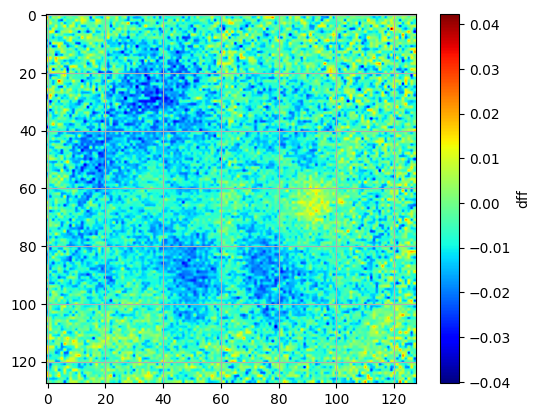

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:42,  2.98it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:38,  3.26it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:35,  3.48it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:34,  3.57it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:35,  3.43it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.46it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:35,  3.45it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:36,  3.29it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:38,  3.11it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:38,  3.09it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.24it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.15it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:36,  3.18it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.25it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.32it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:35,  3.16it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:35,  3.14it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.20it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.14it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.22it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.14it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:34,  3.07it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:34,  3.06it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:34,  3.01it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:33,  3.12it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:33,  3.01it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:32,  3.15it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:30,  3.26it/s]

 23%|██████████████████▎                                                              | 29/128 [00:09<00:30,  3.20it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:30,  3.21it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:29,  3.26it/s]

 25%|████████████████████▎                                                            | 32/128 [00:10<00:30,  3.11it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:30,  3.07it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:29,  3.22it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:27,  3.37it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:27,  3.41it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:27,  3.36it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:26,  3.35it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:26,  3.41it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:28,  3.04it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:28,  3.07it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:26,  3.21it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.30it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:25,  3.34it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:24,  3.39it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:23,  3.42it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:24,  3.28it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:25,  3.15it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:24,  3.17it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.23it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:24,  3.18it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:24,  3.08it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:23,  3.13it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:24,  3.08it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:24,  3.00it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:24,  2.98it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:22,  3.15it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:21,  3.25it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:20,  3.37it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:20,  3.32it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:19,  3.44it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:18,  3.55it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.36it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.10it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.28it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:19,  3.20it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:19,  3.18it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.21it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:18,  3.22it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.24it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:17,  3.20it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:18,  2.99it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:18,  3.05it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:16,  3.18it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:16,  3.31it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.29it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:15,  3.35it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:15,  3.27it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:14,  3.29it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.27it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:14,  3.35it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.33it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.30it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:13,  3.30it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:12,  3.38it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.41it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:11,  3.46it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.25it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:11,  3.26it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:11,  3.33it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:10,  3.43it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.43it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:10,  3.26it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:10,  3.27it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.25it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.18it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.18it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.25it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.37it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.45it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:07,  3.49it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.38it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.29it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.28it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.24it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.34it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.37it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.22it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.18it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.21it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.23it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:05,  3.02it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.11it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.16it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:04,  3.20it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.24it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.05it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:03,  3.07it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.16it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.13it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.24it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.23it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.22it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.22it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.20it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:39<00:00,  3.10it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.17it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.27it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.23it/s]

frame number 200 plotted


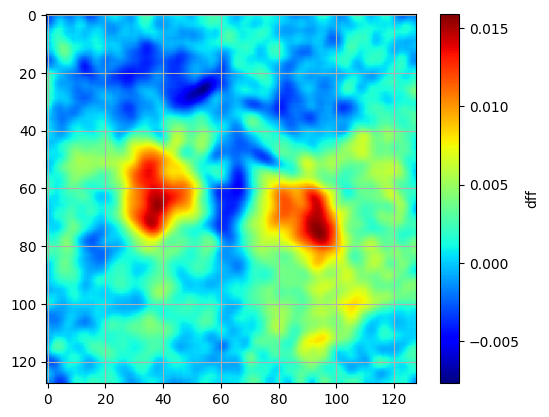

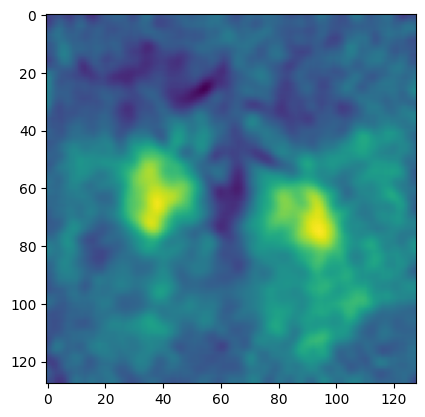

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 20


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 12
fail = 23
total trials = 35


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 29
fail = 16
total trials = 45


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 11
fail = 9
total trials = 20


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34652 [00:00<?, ?it/s]

  8%|█████▉                                                                    | 2798/34652 [00:00<00:01, 27712.57it/s]

 16%|███████████▉                                                              | 5570/34652 [00:00<00:01, 24430.97it/s]

 23%|█████████████████▏                                                        | 8038/34652 [00:00<00:01, 23637.26it/s]

 30%|█████████████████████▉                                                   | 10435/34652 [00:00<00:01, 23675.67it/s]

 38%|███████████████████████████▊                                             | 13216/34652 [00:00<00:00, 25015.97it/s]

 46%|█████████████████████████████████▋                                       | 16018/34652 [00:00<00:00, 25921.85it/s]

 54%|███████████████████████████████████████▋                                 | 18831/34652 [00:00<00:00, 26544.57it/s]

 62%|█████████████████████████████████████████████▎                           | 21504/34652 [00:00<00:00, 26522.58it/s]

 70%|██████████████████████████████████████████████████▉                      | 24162/34652 [00:00<00:00, 25076.41it/s]

 77%|████████████████████████████████████████████████████████▏                | 26687/34652 [00:01<00:00, 24002.60it/s]

 84%|█████████████████████████████████████████████████████████████▎           | 29105/34652 [00:01<00:00, 21531.26it/s]

 90%|█████████████████████████████████████████████████████████████████▉       | 31308/34652 [00:01<00:00, 20670.61it/s]

 96%|██████████████████████████████████████████████████████████████████████▍  | 33409/34652 [00:01<00:00, 19365.42it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34652/34652 [00:01<00:00, 22865.54it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25008.52it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 19118.46it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")